# Mask R-CNN - Inspect Trained Mickey Model

Code and visualizations to test, debug, and evaluate the Mask R-CNN model.

In [1]:
import os
import sys
import random
import math
import re
import time
import numpy as np
import tensorflow as tf
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.patches as patches

# Root directory of the project
ROOT_DIR = os.path.abspath("../../")

# Import Mask RCNN
sys.path.append(ROOT_DIR)  # To find local version of the library
from mrcnn import utils
from mrcnn import visualize
from mrcnn.visualize import display_images
import mrcnn.model as modellib
from mrcnn.model import log

from samples.mickey import mickey

%matplotlib inline 

# Directory to save logs and trained model
MODEL_DIR = os.path.join(ROOT_DIR, "logs")

# Path to Mickey Model trained weights
MICKEY_WEIGHTS_PATH = "E:\Work\MachineLearning\Mickey\mickey20180917T1613\mask_rcnn_mickey_0150.h5"

Using TensorFlow backend.


## Configurations

In [2]:
config = mickey.MickeyConfig()
MICKEY_DIR = os.path.join(ROOT_DIR, "datasets/mickey")
config.display()


Configurations:
BACKBONE                       resnet101
BACKBONE_STRIDES               [4, 8, 16, 32, 64]
BATCH_SIZE                     1
BBOX_STD_DEV                   [0.1 0.1 0.2 0.2]
COMPUTE_BACKBONE_SHAPE         None
DETECTION_MAX_INSTANCES        100
DETECTION_MIN_CONFIDENCE       0.51
DETECTION_NMS_THRESHOLD        0.1
FPN_CLASSIF_FC_LAYERS_SIZE     1024
GPU_COUNT                      1
GRADIENT_CLIP_NORM             5.0
IMAGES_PER_GPU                 1
IMAGE_MAX_DIM                  1024
IMAGE_META_SIZE                14
IMAGE_MIN_DIM                  800
IMAGE_MIN_SCALE                0
IMAGE_RESIZE_MODE              square
IMAGE_SHAPE                    [1024 1024    3]
LEARNING_MOMENTUM              0.9
LEARNING_RATE                  0.0001
LOSS_WEIGHTS                   {'rpn_class_loss': 1.0, 'rpn_bbox_loss': 1.0, 'mrcnn_class_loss': 1.0, 'mrcnn_bbox_loss': 1.0, 'mrcnn_mask_loss': 1.0}
MASK_POOL_SIZE                 14
MASK_SHAPE                     [28, 28]
MAX_GT_INS

In [3]:
# Override the training configurations with a few
# changes for inferencing.
class InferenceConfig(config.__class__):
    # Run detection on one image at a time
    GPU_COUNT = 1
    IMAGES_PER_GPU = 1
    DETECTION_MIN_CONFIDENCE = 0.55
    # Non-max suppression threshold to filter RPN proposals.
    # You can increase this during training to generate more propsals.
    RPN_NMS_THRESHOLD = 1.0

    # If enabled, resizes instance masks to a smaller size to reduce
    # memory load. Recommended when using high-resolution images.
    USE_MINI_MASK = False
    MINI_MASK_SHAPE = (56, 56)  # (height, width) of the mini-mask

    # Number of ROIs per image to feed to classifier/mask heads
    # The Mask RCNN paper uses 512 but often the RPN doesn't generate
    # enough positive proposals to fill this and keep a positive:negative
    # ratio of 1:3. You can increase the number of proposals by adjusting
    # the RPN NMS threshold.
    TRAIN_ROIS_PER_IMAGE = 512

    # Percent of positive ROIs used to train classifier/mask heads
    ROI_POSITIVE_RATIO = 1.0

    # Non-maximum suppression threshold for detection
    DETECTION_NMS_THRESHOLD = 0.3
    
    # Ratios of anchors at each cell (width/height)
    # A value of 1 represents a square anchor, and 0.5 is a wide anchor
    RPN_ANCHOR_RATIOS = [0.5, 1, 2]

    # Anchor stride
    # If 1 then anchors are created for each cell in the backbone feature map.
    # If 2, then anchors are created for every other cell, and so on.
    RPN_ANCHOR_STRIDE = 1
    
    

config = InferenceConfig()
config.display()


Configurations:
BACKBONE                       resnet101
BACKBONE_STRIDES               [4, 8, 16, 32, 64]
BATCH_SIZE                     1
BBOX_STD_DEV                   [0.1 0.1 0.2 0.2]
COMPUTE_BACKBONE_SHAPE         None
DETECTION_MAX_INSTANCES        100
DETECTION_MIN_CONFIDENCE       0.55
DETECTION_NMS_THRESHOLD        0.3
FPN_CLASSIF_FC_LAYERS_SIZE     1024
GPU_COUNT                      1
GRADIENT_CLIP_NORM             5.0
IMAGES_PER_GPU                 1
IMAGE_MAX_DIM                  1024
IMAGE_META_SIZE                14
IMAGE_MIN_DIM                  800
IMAGE_MIN_SCALE                0
IMAGE_RESIZE_MODE              square
IMAGE_SHAPE                    [1024 1024    3]
LEARNING_MOMENTUM              0.9
LEARNING_RATE                  0.0001
LOSS_WEIGHTS                   {'rpn_class_loss': 1.0, 'rpn_bbox_loss': 1.0, 'mrcnn_class_loss': 1.0, 'mrcnn_bbox_loss': 1.0, 'mrcnn_mask_loss': 1.0}
MASK_POOL_SIZE                 14
MASK_SHAPE                     [28, 28]
MAX_GT_INS

## Notebook Preferences

In [4]:
# Device to load the neural network on.
# Useful if you're training a model on the same 
# machine, in which case use CPU and leave the
# GPU for training.
DEVICE = "/gpu:0"  # /cpu:0 or /gpu:0

# Inspect the model in training or inference modes
# values: 'inference' or 'training'
# TODO: code for 'training' test mode not ready yet
TEST_MODE = "inference"

In [5]:
def get_ax(rows=1, cols=1, size=16):
    """Return a Matplotlib Axes array to be used in
    all visualizations in the notebook. Provide a
    central point to control graph sizes.
    
    Adjust the size attribute to control how big to render images
    """
    _, ax = plt.subplots(rows, cols, figsize=(size*cols, size*rows))
    return ax

## Load Validation Dataset

In [6]:
# Load validation dataset
dataset = mickey.MickeyDataset()
dataset.load_mickey(MICKEY_DIR, "val")

# Must call before using the dataset
dataset.prepare()

print("Images: {}\nClasses: {}".format(len(dataset.image_ids), dataset.class_names))

Images: 38
Classes: ['BG', 'mickey']


## Load Model

In [7]:
# Create model in inference mode
with tf.device(DEVICE):
    model = modellib.MaskRCNN(mode=TEST_MODE, model_dir=MODEL_DIR,
                              config=config)

In [8]:
# Load weights
print("Loading weights ", MICKEY_WEIGHTS_PATH)
model.load_weights(MICKEY_WEIGHTS_PATH, by_name=True)

Loading weights  E:\Work\MachineLearning\Mickey\mickey20180917T1613\mask_rcnn_mickey_0150.h5


## Run Detection

Processing  194340ed88d41dbf3caeb83336408b45126ada61.jpg
Processing  disneyland-main-street-hidden-mickey-768x1024.jpg


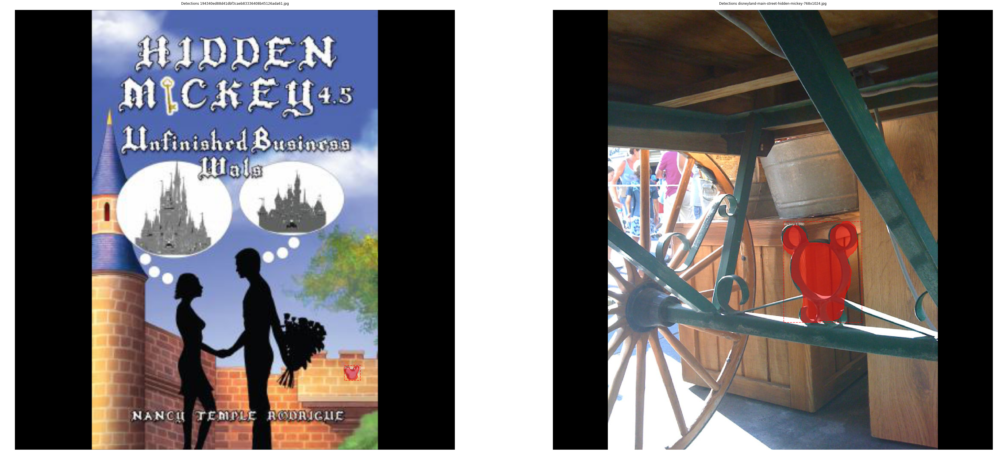

In [57]:
import skimage.io
import skimage.color

filenames = []

prediction_path = os.path.join(MICKEY_DIR, "prediction")
for file in os.listdir(prediction_path):
  filename = os.fsdecode(file)
  if filename.endswith( ('.jpg', '.jpeg', '.png', '.gif') ):
        filenames.append(filename)

numcol = 2
numrows = len(filenames) // numcol
ax = get_ax(numrows, numcol, 32)
imgidx = 0
for filename in filenames:
    prediction_image_filename = prediction_path + '/' + filename 
    print('Processing ', filename)
    image = skimage.io.imread(prediction_image_filename)  
    # If grayscale. Convert to RGB for consistency.
    if image.ndim != 3:
        image = skimage.color.gray2rgb(image)
    # If has an alpha channel, remove it for consistency
    if image.shape[-1] == 4:
        image = image[..., :3]
    
    image, window, scale, padding, crop = utils.resize_image(
            image,
            min_dim=config.IMAGE_MIN_DIM,
            min_scale=config.IMAGE_MIN_SCALE,
            max_dim=config.IMAGE_MAX_DIM,
            mode=config.IMAGE_RESIZE_MODE)
    
    results = model.detect([image], verbose=0)
    # Display results
    #ax = get_ax(1)
    r = results[0]
    visualize.display_instances(image, r['rois'], r['masks'], r['class_ids'], 
                                dataset.class_names, r['scores'], 
                                ax=ax[imgidx // numcol, imgidx % numcol] if np.ndim(ax) == 2 else ax[imgidx % numcol],
                                title="Detections " + filename)
    imgidx += 1
  



image= 19
image ID: mickey.disneyland-main-street-hidden-mickey-768x1024.jpg (19) C:\Programs\py\shared_mickey\mickey_rcnn_proto\datasets/mickey\val\disneyland-main-street-hidden-mickey-768x1024.jpg
(1024, 1024, 3)
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
[{'rois': array([[492, 537, 727, 719]]), 'class_ids': array([1]), 'scores': array([0.99963164], dtype=float32), 'masks': array([[[False],
        [False],
        [False],
        ...,
        [False],
        [False],
        [False]],

       [[False],
        [False],
        [False],
        ...,
        [False],
        [False],
        [False]],

       [[False],
        [Fals

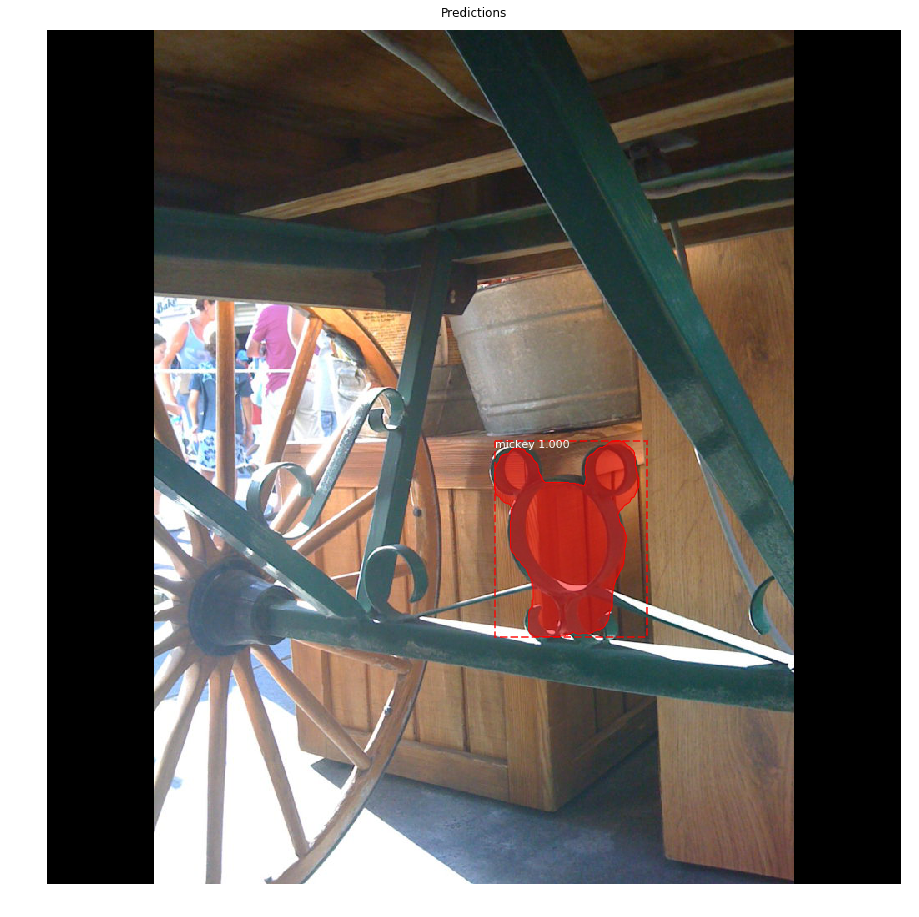

In [10]:
image_id = random.choice(dataset.image_ids)
image_id = 19
print('image=', image_id)
image, image_meta, gt_class_id, gt_bbox, gt_mask =\
    modellib.load_image_gt(dataset, config, image_id, use_mini_mask=False)
info = dataset.image_info[image_id]
print("image ID: {}.{} ({}) {}".format(info["source"], info["id"], image_id, 
                                       dataset.image_reference(image_id)))

print(image.shape)
# Run object detection
results = model.detect([image], verbose=1)
print(results)
# Display results
ax = get_ax(1)
r = results[0]
visualize.display_instances(image, r['rois'], r['masks'], r['class_ids'], 
                            dataset.class_names, r['scores'], ax=ax,
                            title="Predictions")
log("gt_class_id", gt_class_id)
log("gt_bbox", gt_bbox)
log("gt_mask", gt_mask)

image= 0
image ID: mickey.1ukg65uhyoy01.jpg (0) C:\Programs\py\shared_mickey\mickey_rcnn_proto\datasets/mickey\val\1ukg65uhyoy01.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
gt_class_id              shape: (1,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (1, 4)                min:  443.00000  max:  533.00000  int32
gt_mask                  shape: (1024, 1024, 1)       min:    0.00000  max:    1.00000  bool
image= 1
image ID: mickey.47b6dc37b3127ccecd3408feabd700000016100bcm2lnuzysqe3nwk.jpg (1) C:\Programs\py\shared_mickey\mickey_rcnn_proto\datasets/mickey\val\47b6dc37b3127ccecd3408feabd70

gt_class_id              shape: (3,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (3, 4)                min:    5.00000  max:  767.00000  int32
gt_mask                  shape: (1024, 1024, 3)       min:    0.00000  max:    1.00000  bool
image= 10
image ID: mickey.5pcs-lot-63-57cm-black-minnie-mickey-mouse-balloon-head-foil-balloons-birthday-party-decoration-helium.jpg (10) C:\Programs\py\shared_mickey\mickey_rcnn_proto\datasets/mickey\val\5pcs-lot-63-57cm-black-minnie-mickey-mouse-balloon-head-foil-balloons-birthday-party-decoration-helium.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
gt_cla

gt_class_id              shape: (1,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (1, 4)                min:  496.00000  max:  711.00000  int32
gt_mask                  shape: (1024, 1024, 1)       min:    0.00000  max:    1.00000  bool
image= 20
image ID: mickey.disney-pin-bluehm-2.jpg (20) C:\Programs\py\shared_mickey\mickey_rcnn_proto\datasets/mickey\val\disney-pin-bluehm-2.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


c:\programs\python\python36-64\lib\site-packages\matplotlib\pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


gt_class_id              shape: (1,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (1, 4)                min:  220.00000  max:  787.00000  int32
gt_mask                  shape: (1024, 1024, 1)       min:    0.00000  max:    1.00000  bool
image= 21
image ID: mickey.dn-mckyh-tb.jpg (21) C:\Programs\py\shared_mickey\mickey_rcnn_proto\datasets/mickey\val\dn-mckyh-tb.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


c:\programs\python\python36-64\lib\site-packages\matplotlib\pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


gt_class_id              shape: (1,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (1, 4)                min:  339.00000  max:  593.00000  int32
gt_mask                  shape: (1024, 1024, 1)       min:    0.00000  max:    1.00000  bool
image= 22
image ID: mickey.dn-msilh-lp.jpg (22) C:\Programs\py\shared_mickey\mickey_rcnn_proto\datasets/mickey\val\dn-msilh-lp.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


c:\programs\python\python36-64\lib\site-packages\matplotlib\pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


gt_class_id              shape: (1,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (1, 4)                min:   93.00000  max:  898.00000  int32
gt_mask                  shape: (1024, 1024, 1)       min:    0.00000  max:    1.00000  bool
image= 23
image ID: mickey.dsc_0130_edited-1-1024x681.jpg (23) C:\Programs\py\shared_mickey\mickey_rcnn_proto\datasets/mickey\val\dsc_0130_edited-1-1024x681.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


c:\programs\python\python36-64\lib\site-packages\matplotlib\pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


gt_class_id              shape: (1,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (1, 4)                min:  363.00000  max:  662.00000  int32
gt_mask                  shape: (1024, 1024, 1)       min:    0.00000  max:    1.00000  bool
image= 24
image ID: mickey.dsc05594.jpg (24) C:\Programs\py\shared_mickey\mickey_rcnn_proto\datasets/mickey\val\dsc05594.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


c:\programs\python\python36-64\lib\site-packages\matplotlib\pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


gt_class_id              shape: (1,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (1, 4)                min:   19.00000  max:  763.00000  int32
gt_mask                  shape: (1024, 1024, 1)       min:    0.00000  max:    1.00000  bool
image= 25
image ID: mickey.dvdmick1.jpg (25) C:\Programs\py\shared_mickey\mickey_rcnn_proto\datasets/mickey\val\dvdmick1.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


c:\programs\python\python36-64\lib\site-packages\matplotlib\pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


gt_class_id              shape: (1,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (1, 4)                min:  181.00000  max:  650.00000  int32
gt_mask                  shape: (1024, 1024, 1)       min:    0.00000  max:    1.00000  bool
image= 26
image ID: mickey.file_15fa59e8.jpeg (26) C:\Programs\py\shared_mickey\mickey_rcnn_proto\datasets/mickey\val\file_15fa59e8.jpeg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


c:\programs\python\python36-64\lib\site-packages\matplotlib\pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


gt_class_id              shape: (1,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (1, 4)                min:   33.00000  max:  876.00000  int32
gt_mask                  shape: (1024, 1024, 1)       min:    0.00000  max:    1.00000  bool
image= 27
image ID: mickey.finished-mickey-mouse-cake-with-rose-detail-frosting_thumb.jpg (27) C:\Programs\py\shared_mickey\mickey_rcnn_proto\datasets/mickey\val\finished-mickey-mouse-cake-with-rose-detail-frosting_thumb.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


c:\programs\python\python36-64\lib\site-packages\matplotlib\pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


gt_class_id              shape: (1,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (1, 4)                min:  183.00000  max:  861.00000  int32
gt_mask                  shape: (1024, 1024, 1)       min:    0.00000  max:    1.00000  bool
image= 28
image ID: mickey.floralcraft.jpg (28) C:\Programs\py\shared_mickey\mickey_rcnn_proto\datasets/mickey\val\floralcraft.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


c:\programs\python\python36-64\lib\site-packages\matplotlib\pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


gt_class_id              shape: (2,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (2, 4)                min:  266.00000  max:  910.00000  int32
gt_mask                  shape: (1024, 1024, 2)       min:    0.00000  max:    1.00000  bool
image= 29
image ID: mickey.foi3k0zify99u0l.large.jpg (29) C:\Programs\py\shared_mickey\mickey_rcnn_proto\datasets/mickey\val\foi3k0zify99u0l.large.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


c:\programs\python\python36-64\lib\site-packages\matplotlib\pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


gt_class_id              shape: (1,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (1, 4)                min:  182.00000  max:  845.00000  int32
gt_mask                  shape: (1024, 1024, 1)       min:    0.00000  max:    1.00000  bool
image= 30
image ID: mickey.hiddenmickey_issahomes4.jpg (30) C:\Programs\py\shared_mickey\mickey_rcnn_proto\datasets/mickey\val\hiddenmickey_issahomes4.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  196.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:   92.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


c:\programs\python\python36-64\lib\site-packages\matplotlib\pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


gt_class_id              shape: (1,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (1, 4)                min:  495.00000  max:  576.00000  int32
gt_mask                  shape: (1024, 1024, 1)       min:    0.00000  max:    1.00000  bool
image= 31
image ID: mickey.hidden-mickey-720x340.jpg (31) C:\Programs\py\shared_mickey\mickey_rcnn_proto\datasets/mickey\val\hidden-mickey-720x340.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


c:\programs\python\python36-64\lib\site-packages\matplotlib\pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


gt_class_id              shape: (1,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (1, 4)                min:  515.00000  max:  653.00000  int32
gt_mask                  shape: (1024, 1024, 1)       min:    0.00000  max:    1.00000  bool
image= 32
image ID: mickey.hidden-mickey-contemporary.jpg (32) C:\Programs\py\shared_mickey\mickey_rcnn_proto\datasets/mickey\val\hidden-mickey-contemporary.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  131.30000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


c:\programs\python\python36-64\lib\site-packages\matplotlib\pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)



*** No instances to display *** 

gt_class_id              shape: (1,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (1, 4)                min:  312.00000  max:  788.00000  int32
gt_mask                  shape: (1024, 1024, 1)       min:    0.00000  max:    1.00000  bool
image= 33
image ID: mickey.hidden-mickey-downtown-disney.jpg (33) C:\Programs\py\shared_mickey\mickey_rcnn_proto\datasets/mickey\val\hidden-mickey-downtown-disney.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


c:\programs\python\python36-64\lib\site-packages\matplotlib\pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


gt_class_id              shape: (1,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (1, 4)                min:  285.00000  max:  769.00000  int32
gt_mask                  shape: (1024, 1024, 1)       min:    0.00000  max:    1.00000  bool
image= 34
image ID: mickey.hidden-mickey-mouse-disney-animation-7.jpg (34) C:\Programs\py\shared_mickey\mickey_rcnn_proto\datasets/mickey\val\hidden-mickey-mouse-disney-animation-7.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


c:\programs\python\python36-64\lib\site-packages\matplotlib\pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


gt_class_id              shape: (1,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (1, 4)                min:  472.00000  max:  891.00000  int32
gt_mask                  shape: (1024, 1024, 1)       min:    0.00000  max:    1.00000  bool
image= 35
image ID: mickey.hidden-mickey-pin-information.jpg (35) C:\Programs\py\shared_mickey\mickey_rcnn_proto\datasets/mickey\val\hidden-mickey-pin-information.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  254.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  150.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


c:\programs\python\python36-64\lib\site-packages\matplotlib\pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


gt_class_id              shape: (1,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (1, 4)                min:  299.00000  max:  802.00000  int32
gt_mask                  shape: (1024, 1024, 1)       min:    0.00000  max:    1.00000  bool
image= 36
image ID: mickey.hiddenmickeypolynesianresort.jpg (36) C:\Programs\py\shared_mickey\mickey_rcnn_proto\datasets/mickey\val\hiddenmickeypolynesianresort.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  254.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  150.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


c:\programs\python\python36-64\lib\site-packages\matplotlib\pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


gt_class_id              shape: (1,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (1, 4)                min:  151.00000  max:  910.00000  int32
gt_mask                  shape: (1024, 1024, 1)       min:    0.00000  max:    1.00000  bool
image= 37
image ID: mickey.hmindi.jpg (37) C:\Programs\py\shared_mickey\mickey_rcnn_proto\datasets/mickey\val\hmindi.jpg
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32


c:\programs\python\python36-64\lib\site-packages\matplotlib\pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


gt_class_id              shape: (1,)                  min:    1.00000  max:    1.00000  int32
gt_bbox                  shape: (1, 4)                min:  431.00000  max:  545.00000  int32
gt_mask                  shape: (1024, 1024, 1)       min:    0.00000  max:    1.00000  bool


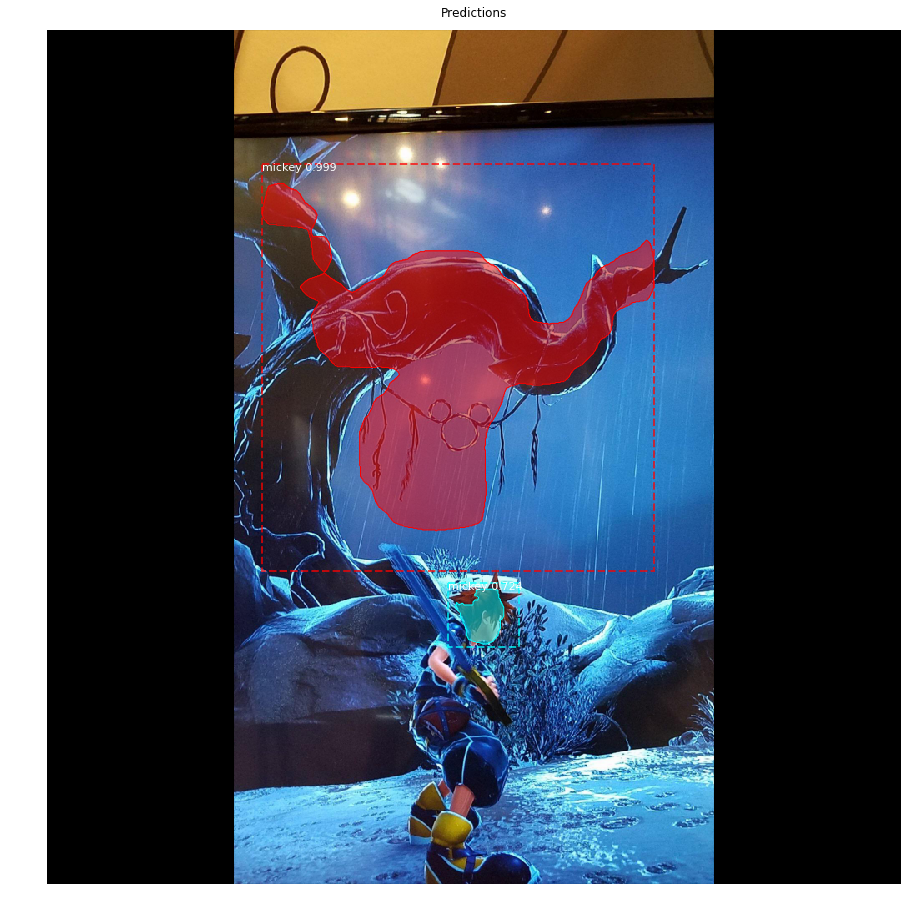

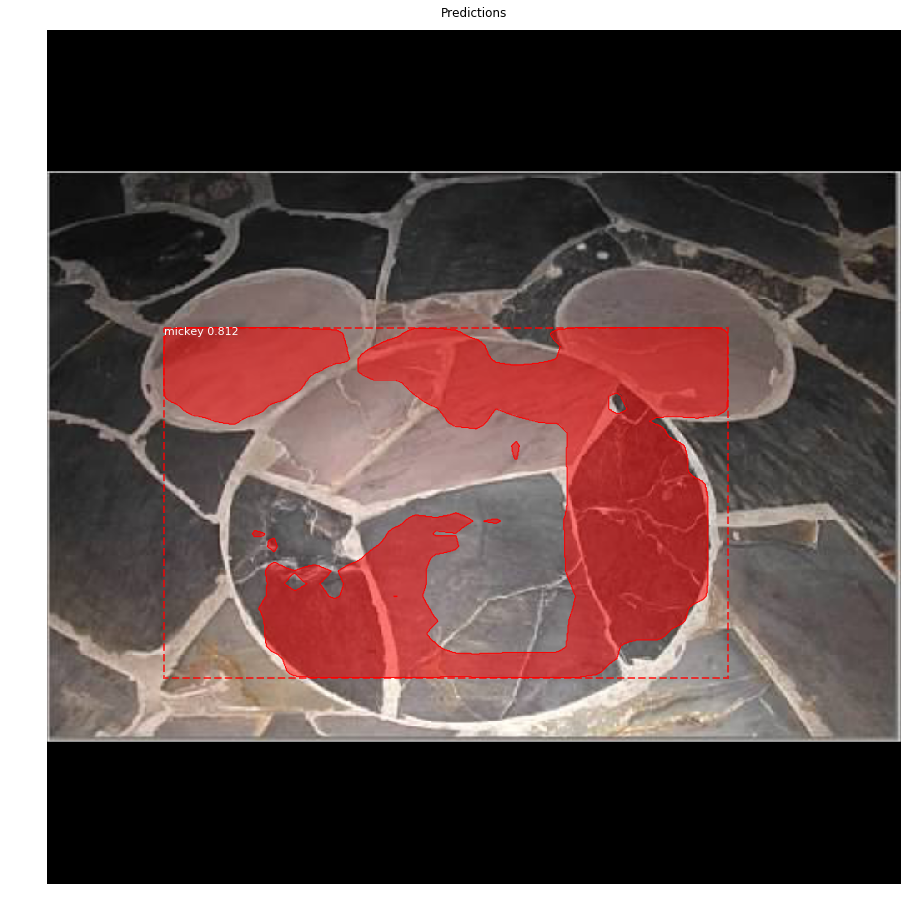

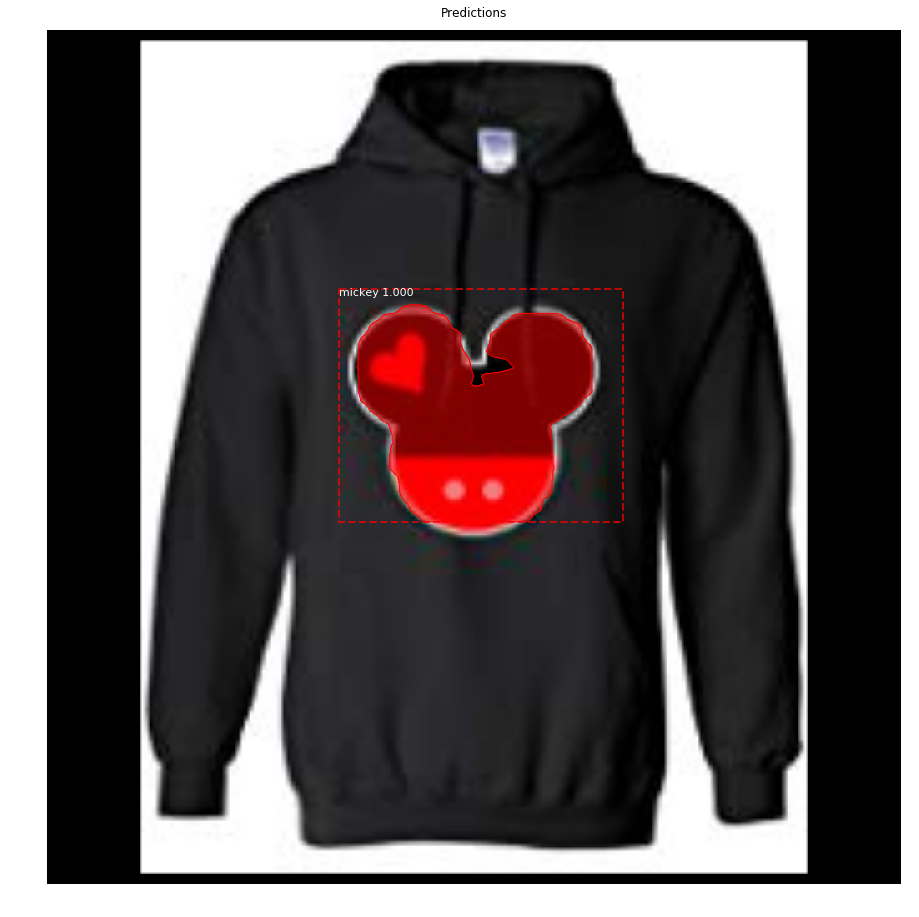

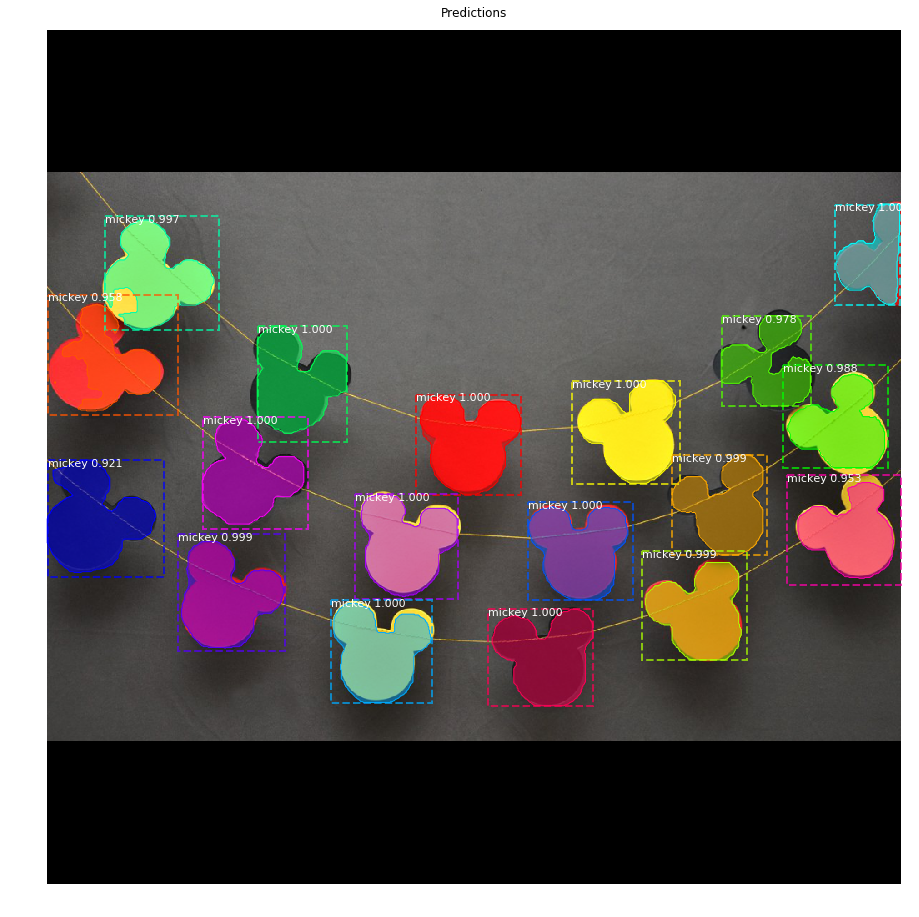

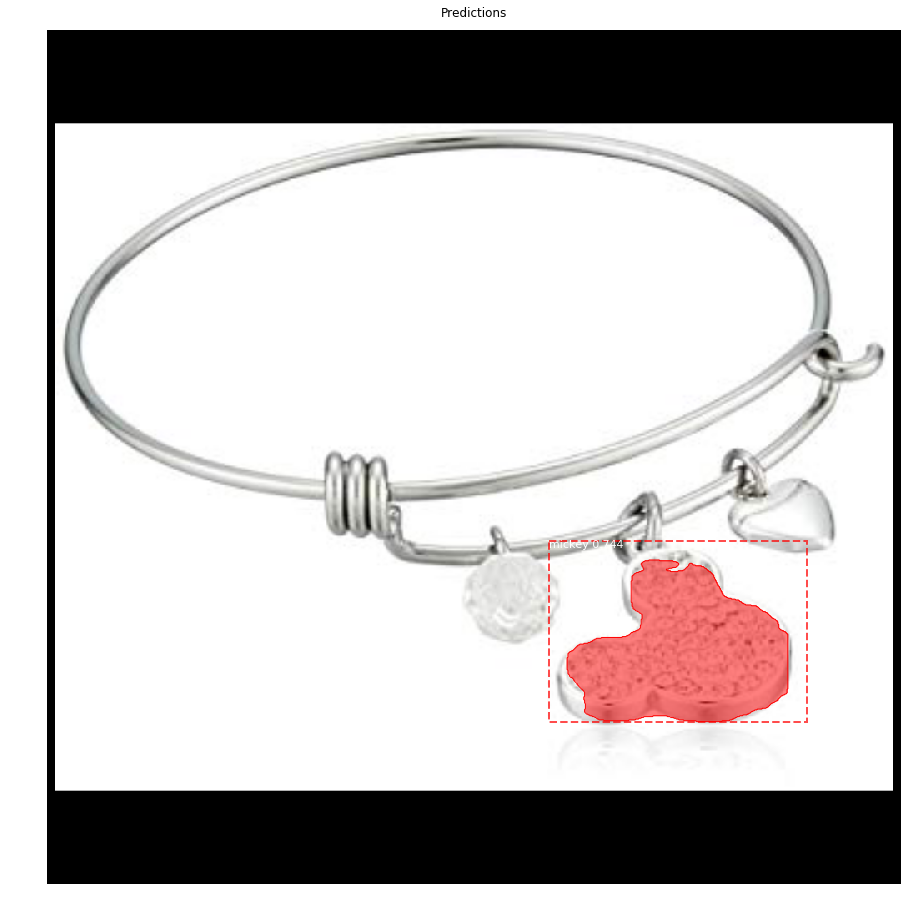

...

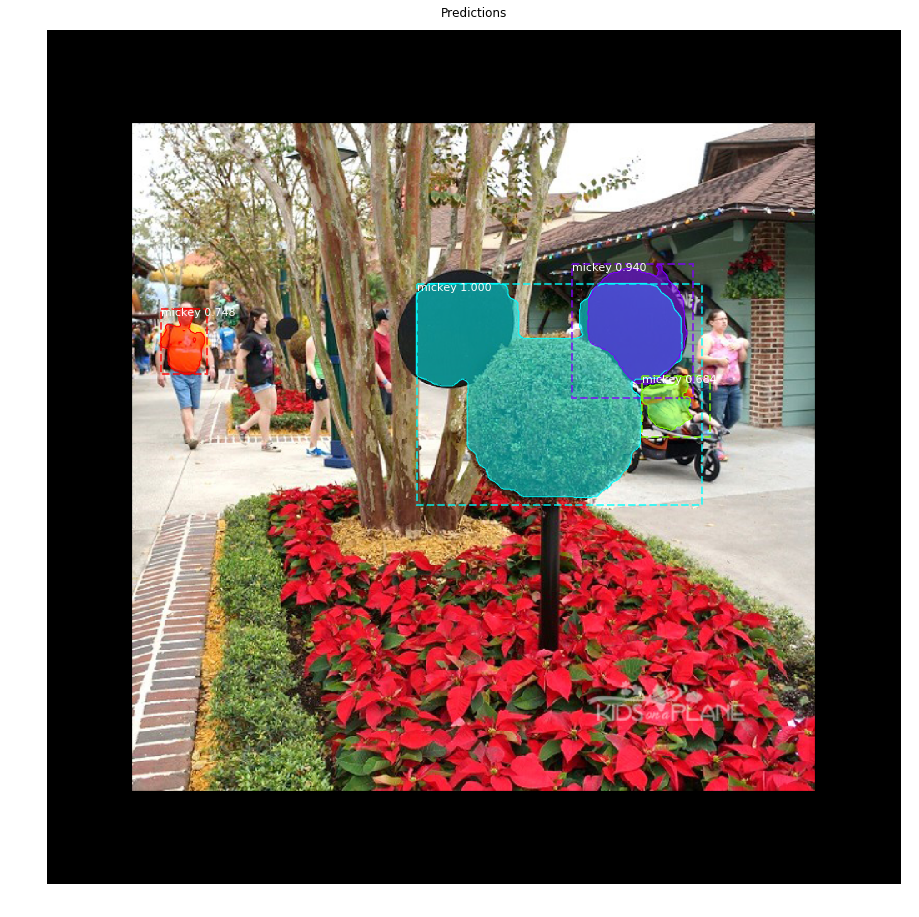

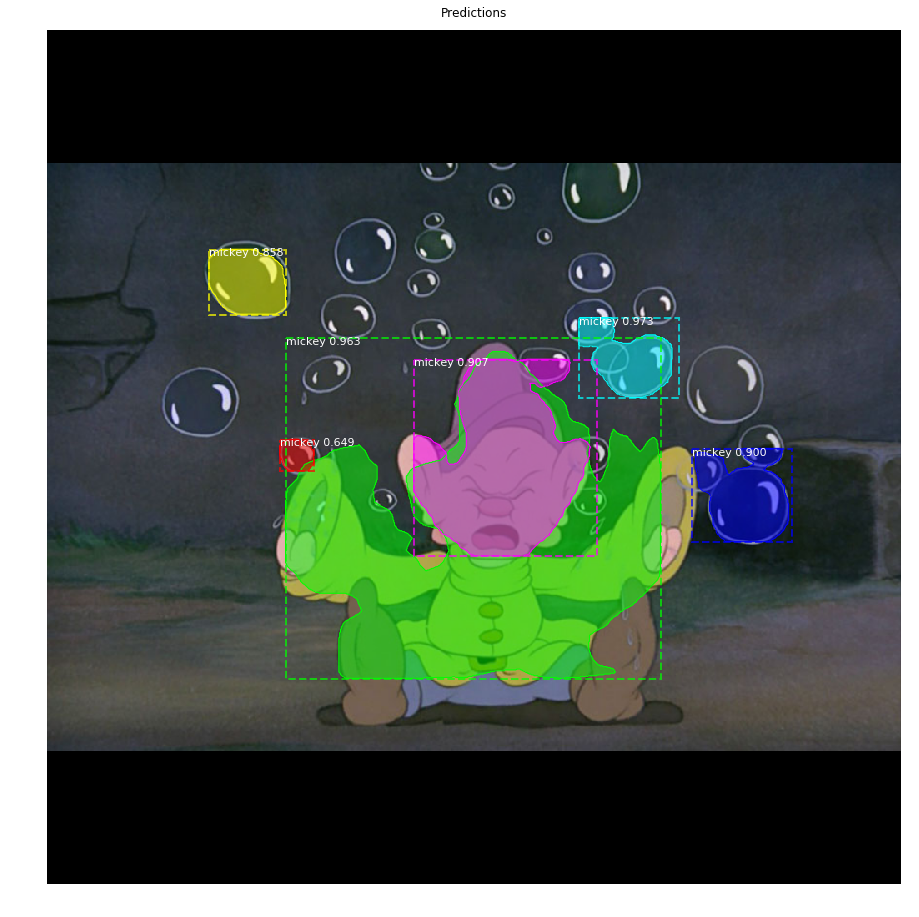

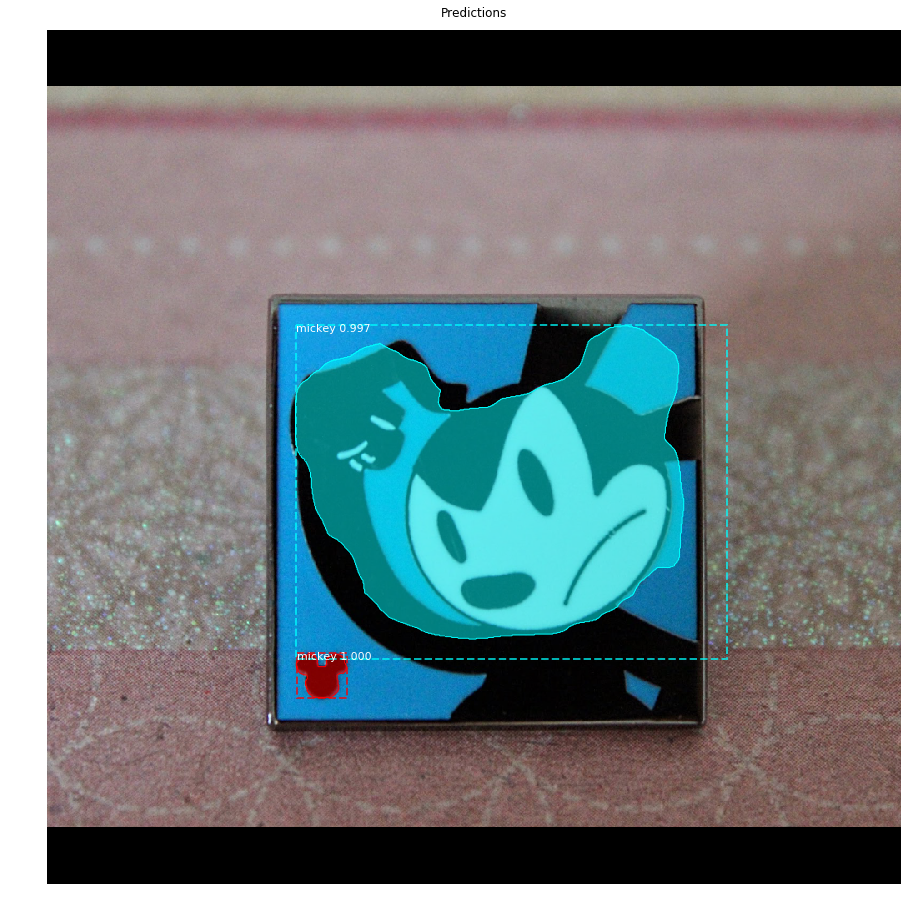

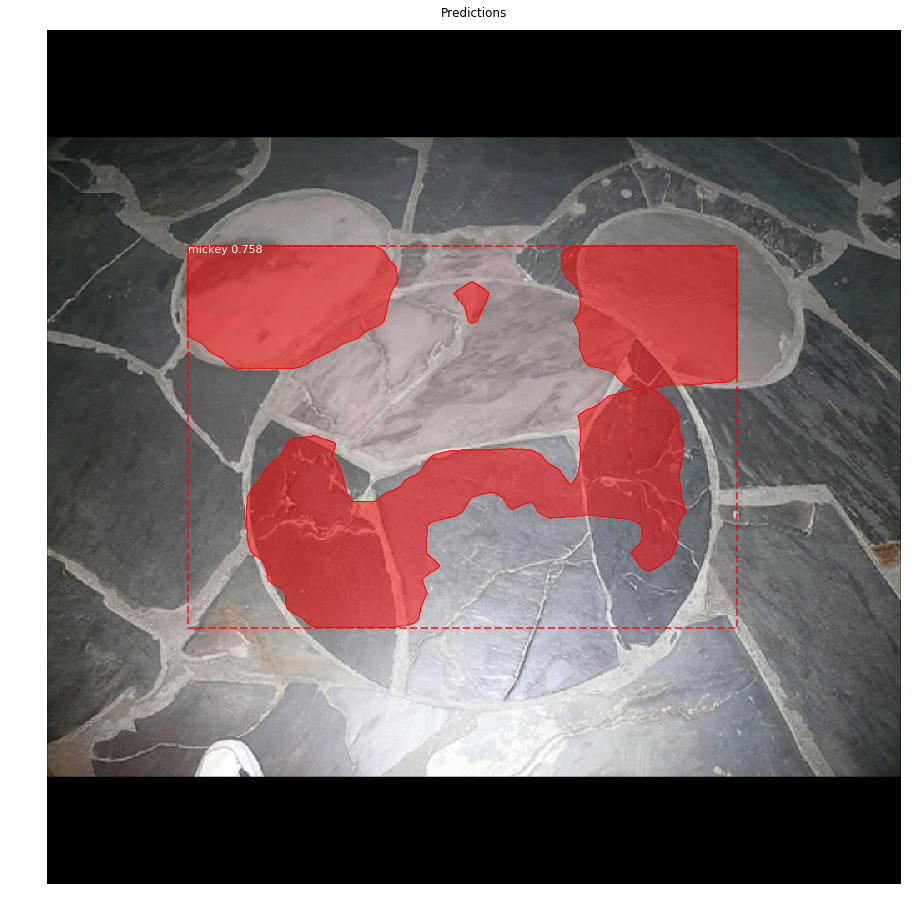

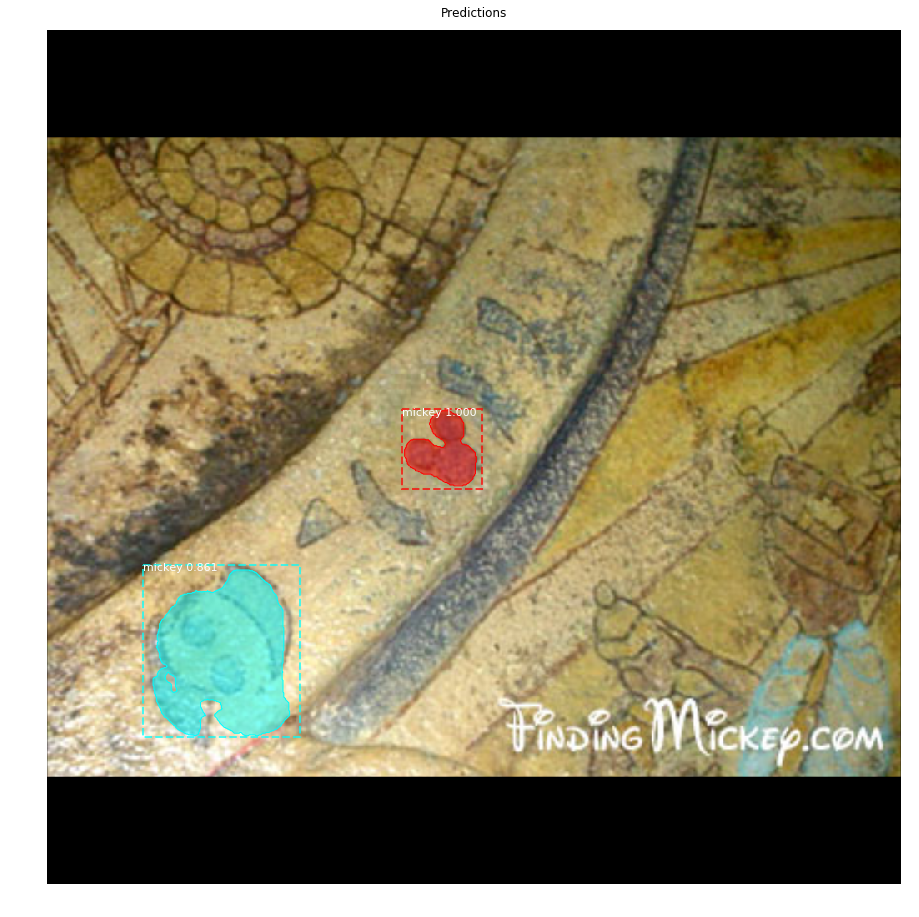

In [11]:
for image_id in dataset.image_ids:
    print('image=', image_id)
    image, image_meta, gt_class_id, gt_bbox, gt_mask =\
        modellib.load_image_gt(dataset, config, image_id, use_mini_mask=False)
    info = dataset.image_info[image_id]
    print("image ID: {}.{} ({}) {}".format(info["source"], info["id"], image_id, 
                                           dataset.image_reference(image_id)))

    # Run object detection
    results = model.detect([image], verbose=1)

    # Display results
    ax = get_ax(1)
    r = results[0]
    visualize.display_instances(image, r['rois'], r['masks'], r['class_ids'], 
                                dataset.class_names, r['scores'], ax=ax,
                                title="Predictions")
    log("gt_class_id", gt_class_id)
    log("gt_bbox", gt_bbox)
    log("gt_mask", gt_mask)

## Step by Step Prediction

image= 19
image ID: mickey.disneyland-main-street-hidden-mickey-768x1024.jpg (19) C:\Programs\py\shared_mickey\mickey_rcnn_proto\datasets/mickey\val\disneyland-main-street-hidden-mickey-768x1024.jpg
(1024, 1024, 3)
Processing 1 images
image                    shape: (1024, 1024, 3)       min:    0.00000  max:  255.00000  uint8
molded_images            shape: (1, 1024, 1024, 3)    min: -123.70000  max:  151.10000  float64
image_metas              shape: (1, 14)               min:    0.00000  max: 1024.00000  int32
anchors                  shape: (1, 261888, 4)        min:   -0.35390  max:    1.29134  float32
[{'rois': array([[492, 537, 727, 719]]), 'class_ids': array([1]), 'scores': array([0.99963164], dtype=float32), 'masks': array([[[False],
        [False],
        [False],
        ...,
        [False],
        [False],
        [False]],

       [[False],
        [False],
        [False],
        ...,
        [False],
        [False],
        [False]],

       [[False],
        [Fals

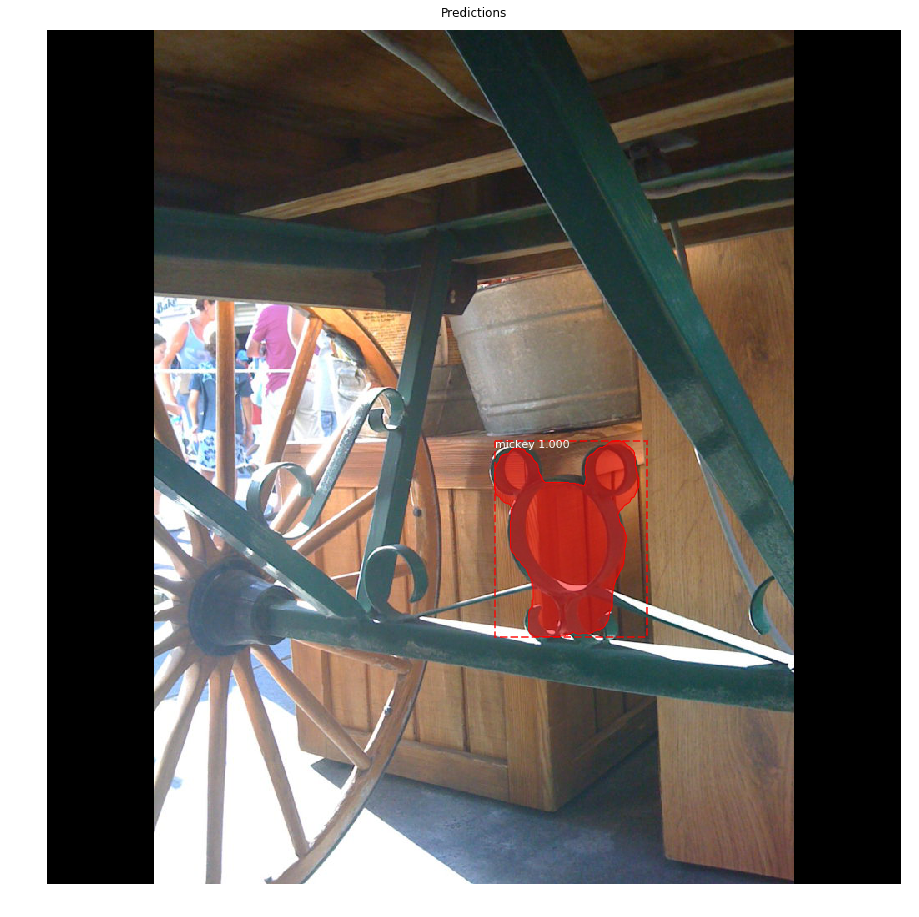

In [12]:
image_id = 19
print('image=', image_id)
image, image_meta, gt_class_id, gt_bbox, gt_mask =\
    modellib.load_image_gt(dataset, config, image_id, use_mini_mask=False)
info = dataset.image_info[image_id]
print("image ID: {}.{} ({}) {}".format(info["source"], info["id"], image_id, 
                                       dataset.image_reference(image_id)))

print(image.shape)
# Run object detection
results = model.detect([image], verbose=1)
print(results)
# Display results
ax = get_ax(1)
r = results[0]
visualize.display_instances(image, r['rois'], r['masks'], r['class_ids'], 
                            dataset.class_names, r['scores'], ax=ax,
                            title="Predictions")
log("gt_class_id", gt_class_id)
log("gt_bbox", gt_bbox)
log("gt_mask", gt_mask)

## Stage 1: Region Proposal Network

The Region Proposal Network (RPN) runs a lightweight binary classifier on a lot of boxes (anchors) over the image and returns object/no-object scores. Anchors with high *objectness* score (positive anchors) are passed to the stage two to be classified.

Often, even positive anchors don't cover objects fully. So the RPN also regresses a refinement (a delta in location and size) to be applied to the anchors to shift it and resize it a bit to the correct boundaries of the object.

### 1.a RPN Targets

The RPN targets are the training values for the RPN. To generate the targets, we start with a grid of anchors that cover the full image at different scales, and then we compute the IoU of the anchors with ground truth object. Positive anchors are those that have an IoU >= 0.7 with any ground truth object, and negative anchors are those that don't cover any object by more than 0.3 IoU. Anchors in between (i.e. cover an object by IoU >= 0.3 but < 0.7) are considered neutral and excluded from training.

To train the RPN regressor, we also compute the shift and resizing needed to make the anchor cover the ground truth object completely.

In [13]:
# Generate RPN trainig targets
# target_rpn_match is 1 for positive anchors, -1 for negative anchors
# and 0 for neutral anchors.
target_rpn_match, target_rpn_bbox = modellib.build_rpn_targets(
    image.shape, model.anchors, gt_class_id, gt_bbox, model.config)
log("target_rpn_match", target_rpn_match)
log("target_rpn_bbox", target_rpn_bbox)

positive_anchor_ix = np.where(target_rpn_match[:] == 1)[0]
negative_anchor_ix = np.where(target_rpn_match[:] == -1)[0]
neutral_anchor_ix = np.where(target_rpn_match[:] == 0)[0]
positive_anchors = model.anchors[positive_anchor_ix]
negative_anchors = model.anchors[negative_anchor_ix]
neutral_anchors = model.anchors[neutral_anchor_ix]
log("positive_anchors", positive_anchors)
log("negative_anchors", negative_anchors)
log("neutral anchors", neutral_anchors)

# Apply refinement deltas to positive anchors
refined_anchors = utils.apply_box_deltas(
    positive_anchors,
    target_rpn_bbox[:positive_anchors.shape[0]] * model.config.RPN_BBOX_STD_DEV)
log("refined_anchors", refined_anchors, )


target_rpn_match         shape: (261888,)             min:   -1.00000  max:    1.00000  int32
target_rpn_bbox          shape: (256, 4)              min:   -1.67846  max:    0.58594  float64
positive_anchors         shape: (1, 4)                min:  448.00000  max:  736.00000  float64
negative_anchors         shape: (255, 4)              min:  -45.25483  max: 1053.25483  float64
neutral anchors          shape: (261632, 4)           min: -362.03867  max: 1322.03867  float64
refined_anchors          shape: (1, 4)                min:  496.00000  max:  711.00000  float32


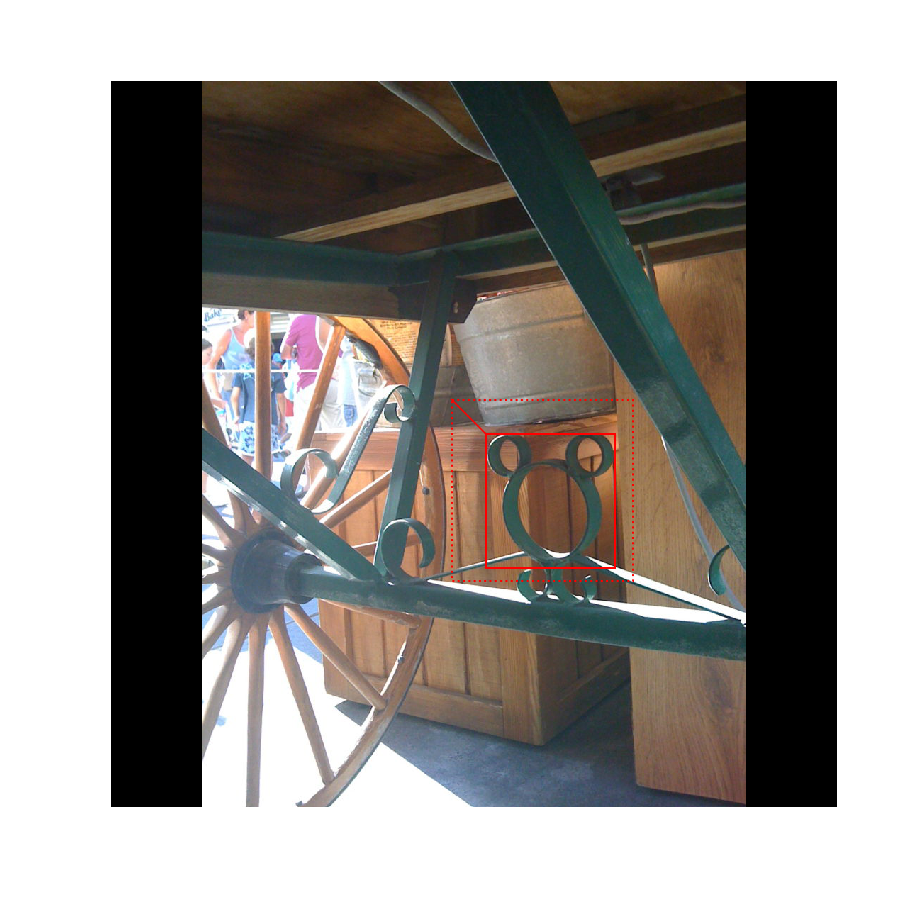

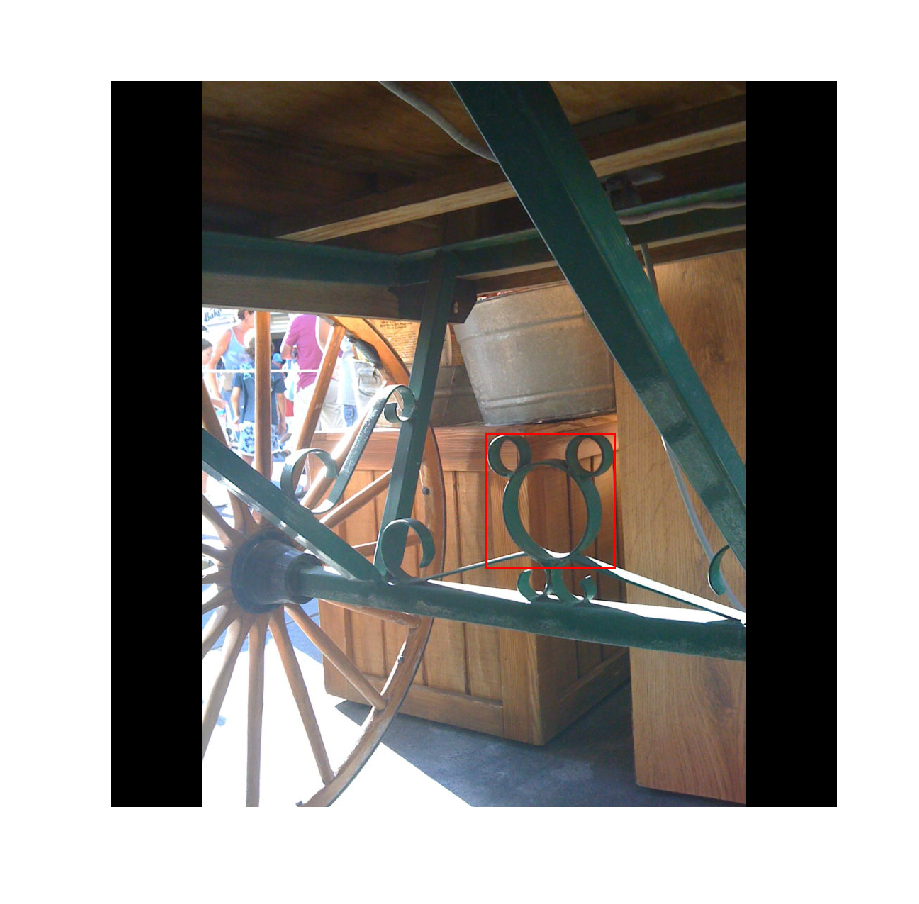

In [14]:
# Display positive anchors before refinement (dotted) and
# after refinement (solid).
visualize.draw_boxes(image, boxes=positive_anchors, refined_boxes=refined_anchors, ax=get_ax())
visualize.draw_boxes(image, refined_boxes=refined_anchors, ax=get_ax())

### 1.b RPN Predictions

Here we run the RPN graph and display its predictions.

In [15]:
print(model.keras_model.summary())

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_image (InputLayer)        (None, None, None, 3 0                                            
__________________________________________________________________________________________________
zero_padding2d_1 (ZeroPadding2D (None, None, None, 3 0           input_image[0][0]                
__________________________________________________________________________________________________
conv1 (Conv2D)                  (None, None, None, 6 9472        zero_padding2d_1[0][0]           
__________________________________________________________________________________________________
bn_conv1 (BatchNorm)            (None, None, None, 6 256         conv1[0][0]                      
__________________________________________________________________________________________________
activation

In [16]:
# Run RPN sub-graph
pillar = model.keras_model.get_layer("ROI").output  # node to start searching from
print(pillar)

# TF 1.4 introduces a new version of NMS. Search for both names to support TF 1.3 and 1.4
nms_node = model.ancestor(pillar, "ROI/rpn_non_max_suppression:0")
if nms_node is None:
    nms_node = model.ancestor(pillar, "ROI/rpn_non_max_suppression/NonMaxSuppressionV2:0")
if nms_node is None:
    nms_node = model.ancestor(pillar, "ROI/rpn_non_max_suppression/NonMaxSuppressionV3:0")
print(nms_node)
rpn = model.run_graph([image], [
    ("rpn_class", model.keras_model.get_layer("rpn_class").output),
    ("pre_nms_anchors", model.ancestor(pillar, "ROI/pre_nms_anchors:0")),
    ("refined_anchors", model.ancestor(pillar, "ROI/refined_anchors:0")),
    ("refined_anchors_clipped", model.ancestor(pillar, "ROI/refined_anchors_clipped:0")),
    ("post_nms_anchor_ix", nms_node),
    ("proposals", model.keras_model.get_layer("ROI").output),
])

Tensor("ROI/packed_2:0", shape=(1, ?, 4), dtype=float32, device=/device:GPU:0)
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression:0')
In ancestor p.name= ROI/Pad:0
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression:0')
In ancestor p.name= ROI/GatherV2_3:0
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression:0')
In ancestor p.name= ROI/strided_slice_21:0
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression:0')
In ancestor p.name= ROI/refined_anchors_clipped:0
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression:0')
In ancestor p.name= ROI/clipped_boxes:0
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression:0')
In ancestor p.name= ROI/Maximum:0
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression:0')
In ancestor p.name= ROI/Minimum_1:0
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression:0')
In ancestor p.name= ROI/split_1:0
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression:0')
In ancestor p.

Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression:0')
In ancestor p.name= activation_34/Relu:0
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression:0')
In ancestor p.name= bn4j_branch2a/batchnorm/add_1:0
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression:0')
In ancestor p.name= bn4j_branch2a/batchnorm/mul_1:0
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression:0')
In ancestor p.name= res4j_branch2a/BiasAdd:0
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression:0')
In ancestor p.name= res4j_branch2a/convolution:0
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression:0')
In ancestor p.name= res4i_out/Relu:0
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression:0')
In ancestor p.name= add_16/add:0
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression:0')
In ancestor p.name= bn4i_branch2c/batchnorm/add_1:0
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression:0')
In ancestor p.name= bn4i_branch2c/ba

Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression:0')
In ancestor p.name= bn3b_branch2c/batchnorm/mul_1:0
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression:0')
In ancestor p.name= res3b_branch2c/BiasAdd:0
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression:0')
In ancestor p.name= res3b_branch2c/convolution:0
In ancestor p.name= res3b_branch2c/bias/read:0
In ancestor p.name= bn3b_branch2c/batchnorm/mul:0
In ancestor p.name= bn3b_branch2c/batchnorm/sub:0
In ancestor p.name= res3a_out/Relu:0
In ancestor p.name= res3c_branch2a/kernel/read:0
In ancestor p.name= res3c_branch2a/bias/read:0
In ancestor p.name= bn3c_branch2a/batchnorm/mul:0
In ancestor p.name= bn3c_branch2a/batchnorm/sub:0
In ancestor p.name= res3c_branch2b/kernel/read:0
In ancestor p.name= res3c_branch2b/bias/read:0
In ancestor p.name= bn3c_branch2b/batchnorm/mul:0
In ancestor p.name= bn3c_branch2b/batchnorm/sub:0
In ancestor p.name= res3c_branch2c/kernel/read:0
In ancestor p.name= res3c_br

In ancestor p.name= res4o_branch2c/bias/read:0
In ancestor p.name= bn4o_branch2c/batchnorm/mul:0
In ancestor p.name= bn4o_branch2c/batchnorm/sub:0
In ancestor p.name= res4p_branch2a/kernel/read:0
In ancestor p.name= res4p_branch2a/bias/read:0
In ancestor p.name= bn4p_branch2a/batchnorm/mul:0
In ancestor p.name= bn4p_branch2a/batchnorm/sub:0
In ancestor p.name= res4p_branch2b/kernel/read:0
In ancestor p.name= res4p_branch2b/bias/read:0
In ancestor p.name= bn4p_branch2b/batchnorm/mul:0
In ancestor p.name= bn4p_branch2b/batchnorm/sub:0
In ancestor p.name= res4p_branch2c/kernel/read:0
In ancestor p.name= res4p_branch2c/bias/read:0
In ancestor p.name= bn4p_branch2c/batchnorm/mul:0
In ancestor p.name= bn4p_branch2c/batchnorm/sub:0
In ancestor p.name= res4q_branch2a/kernel/read:0
In ancestor p.name= res4q_branch2a/bias/read:0
In ancestor p.name= bn4q_branch2a/batchnorm/mul:0
In ancestor p.name= bn4q_branch2a/batchnorm/sub:0
In ancestor p.name= res4q_branch2b/kernel/read:0
In ancestor p.name= 

In ancestor p.name= bn4v_branch2c/batchnorm/add_1:0
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression(\\_\\d+)*/NonMaxSuppressionV2:0')
In ancestor p.name= bn4v_branch2c/batchnorm/mul_1:0
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression(\\_\\d+)*/NonMaxSuppressionV2:0')
In ancestor p.name= res4v_branch2c/BiasAdd:0
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression(\\_\\d+)*/NonMaxSuppressionV2:0')
In ancestor p.name= res4v_branch2c/convolution:0
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression(\\_\\d+)*/NonMaxSuppressionV2:0')
In ancestor p.name= activation_59/Relu:0
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression(\\_\\d+)*/NonMaxSuppressionV2:0')
In ancestor p.name= bn4v_branch2b/batchnorm/add_1:0
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression(\\_\\d+)*/NonMaxSuppressionV2:0')
In ancestor p.name= bn4v_branch2b/batchnorm/mul_1:0
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression(\\_\\d+)*/No

Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression(\\_\\d+)*/NonMaxSuppressionV2:0')
In ancestor p.name= bn4g_branch2a/batchnorm/add_1:0
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression(\\_\\d+)*/NonMaxSuppressionV2:0')
In ancestor p.name= bn4g_branch2a/batchnorm/mul_1:0
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression(\\_\\d+)*/NonMaxSuppressionV2:0')
In ancestor p.name= res4g_branch2a/BiasAdd:0
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression(\\_\\d+)*/NonMaxSuppressionV2:0')
In ancestor p.name= res4g_branch2a/convolution:0
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression(\\_\\d+)*/NonMaxSuppressionV2:0')
In ancestor p.name= res4f_out/Relu:0
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression(\\_\\d+)*/NonMaxSuppressionV2:0')
In ancestor p.name= add_13/add:0
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression(\\_\\d+)*/NonMaxSuppressionV2:0')
In ancestor p.name= bn4f_branch2c/batchnorm/add_1:0
L

In ancestor p.name= bn4q_branch2a/batchnorm/sub:0
In ancestor p.name= res4q_branch2b/kernel/read:0
In ancestor p.name= res4q_branch2b/bias/read:0
In ancestor p.name= bn4q_branch2b/batchnorm/mul:0
In ancestor p.name= bn4q_branch2b/batchnorm/sub:0
In ancestor p.name= res4q_branch2c/kernel/read:0
In ancestor p.name= res4q_branch2c/bias/read:0
In ancestor p.name= bn4q_branch2c/batchnorm/mul:0
In ancestor p.name= bn4q_branch2c/batchnorm/sub:0
In ancestor p.name= res4r_branch2a/kernel/read:0
In ancestor p.name= res4r_branch2a/bias/read:0
In ancestor p.name= bn4r_branch2a/batchnorm/mul:0
In ancestor p.name= bn4r_branch2a/batchnorm/sub:0
In ancestor p.name= res4r_branch2b/kernel/read:0
In ancestor p.name= res4r_branch2b/bias/read:0
In ancestor p.name= bn4r_branch2b/batchnorm/mul:0
In ancestor p.name= bn4r_branch2b/batchnorm/sub:0
In ancestor p.name= res4r_branch2c/kernel/read:0
In ancestor p.name= res4r_branch2c/bias/read:0
In ancestor p.name= bn4r_branch2c/batchnorm/mul:0
In ancestor p.name= 

Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression(\\_\\d+)*/NonMaxSuppressionV3:0')
In ancestor p.name= fpn_p4upsampled/ResizeNearestNeighbor:0
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression(\\_\\d+)*/NonMaxSuppressionV3:0')
In ancestor p.name= fpn_p4add/add:0
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression(\\_\\d+)*/NonMaxSuppressionV3:0')
In ancestor p.name= fpn_p5upsampled/ResizeNearestNeighbor:0
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression(\\_\\d+)*/NonMaxSuppressionV3:0')
In ancestor p.name= fpn_c5p5/BiasAdd:0
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression(\\_\\d+)*/NonMaxSuppressionV3:0')
In ancestor p.name= fpn_c5p5/convolution:0
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression(\\_\\d+)*/NonMaxSuppressionV3:0')
In ancestor p.name= res5c_out/Relu:0
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression(\\_\\d+)*/NonMaxSuppressionV3:0')
In ancestor p.name= add_33/add:0
Looking for  

In ancestor p.name= res4k_out/Relu:0
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression(\\_\\d+)*/NonMaxSuppressionV3:0')
In ancestor p.name= add_18/add:0
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression(\\_\\d+)*/NonMaxSuppressionV3:0')
In ancestor p.name= bn4k_branch2c/batchnorm/add_1:0
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression(\\_\\d+)*/NonMaxSuppressionV3:0')
In ancestor p.name= bn4k_branch2c/batchnorm/mul_1:0
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression(\\_\\d+)*/NonMaxSuppressionV3:0')
In ancestor p.name= res4k_branch2c/BiasAdd:0
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression(\\_\\d+)*/NonMaxSuppressionV3:0')
In ancestor p.name= res4k_branch2c/convolution:0
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression(\\_\\d+)*/NonMaxSuppressionV3:0')
In ancestor p.name= activation_37/Relu:0
Looking for  re.compile('ROI(\\_\\d+)*/rpn_non_max_suppression(\\_\\d+)*/NonMaxSuppressionV3:0')
In ancestor 

In ancestor p.name= bn4d_branch2b/batchnorm/sub:0
In ancestor p.name= res4d_branch2c/kernel/read:0
In ancestor p.name= res4d_branch2c/bias/read:0
In ancestor p.name= bn4d_branch2c/batchnorm/mul:0
In ancestor p.name= bn4d_branch2c/batchnorm/sub:0
In ancestor p.name= res4e_branch2a/kernel/read:0
In ancestor p.name= res4e_branch2a/bias/read:0
In ancestor p.name= bn4e_branch2a/batchnorm/mul:0
In ancestor p.name= bn4e_branch2a/batchnorm/sub:0
In ancestor p.name= res4e_branch2b/kernel/read:0
In ancestor p.name= res4e_branch2b/bias/read:0
In ancestor p.name= bn4e_branch2b/batchnorm/mul:0
In ancestor p.name= bn4e_branch2b/batchnorm/sub:0
In ancestor p.name= res4e_branch2c/kernel/read:0
In ancestor p.name= res4e_branch2c/bias/read:0
In ancestor p.name= bn4e_branch2c/batchnorm/mul:0
In ancestor p.name= bn4e_branch2c/batchnorm/sub:0
In ancestor p.name= res4f_branch2a/kernel/read:0
In ancestor p.name= res4f_branch2a/bias/read:0
In ancestor p.name= bn4f_branch2a/batchnorm/mul:0
In ancestor p.name= 

In ancestor p.name= res5b_branch2b/kernel/read:0
In ancestor p.name= res5b_branch2b/bias/read:0
In ancestor p.name= bn5b_branch2b/batchnorm/mul:0
In ancestor p.name= bn5b_branch2b/batchnorm/sub:0
In ancestor p.name= res5b_branch2c/kernel/read:0
In ancestor p.name= res5b_branch2c/bias/read:0
In ancestor p.name= bn5b_branch2c/batchnorm/mul:0
In ancestor p.name= bn5b_branch2c/batchnorm/sub:0
In ancestor p.name= res5c_branch2a/kernel/read:0
In ancestor p.name= res5c_branch2a/bias/read:0
In ancestor p.name= bn5c_branch2a/batchnorm/mul:0
In ancestor p.name= bn5c_branch2a/batchnorm/sub:0
In ancestor p.name= res5c_branch2b/kernel/read:0
In ancestor p.name= res5c_branch2b/bias/read:0
In ancestor p.name= bn5c_branch2b/batchnorm/mul:0
In ancestor p.name= bn5c_branch2b/batchnorm/sub:0
In ancestor p.name= res5c_branch2c/kernel/read:0
In ancestor p.name= res5c_branch2c/bias/read:0
In ancestor p.name= bn5c_branch2c/batchnorm/mul:0
In ancestor p.name= bn5c_branch2c/batchnorm/sub:0
In ancestor p.name= 

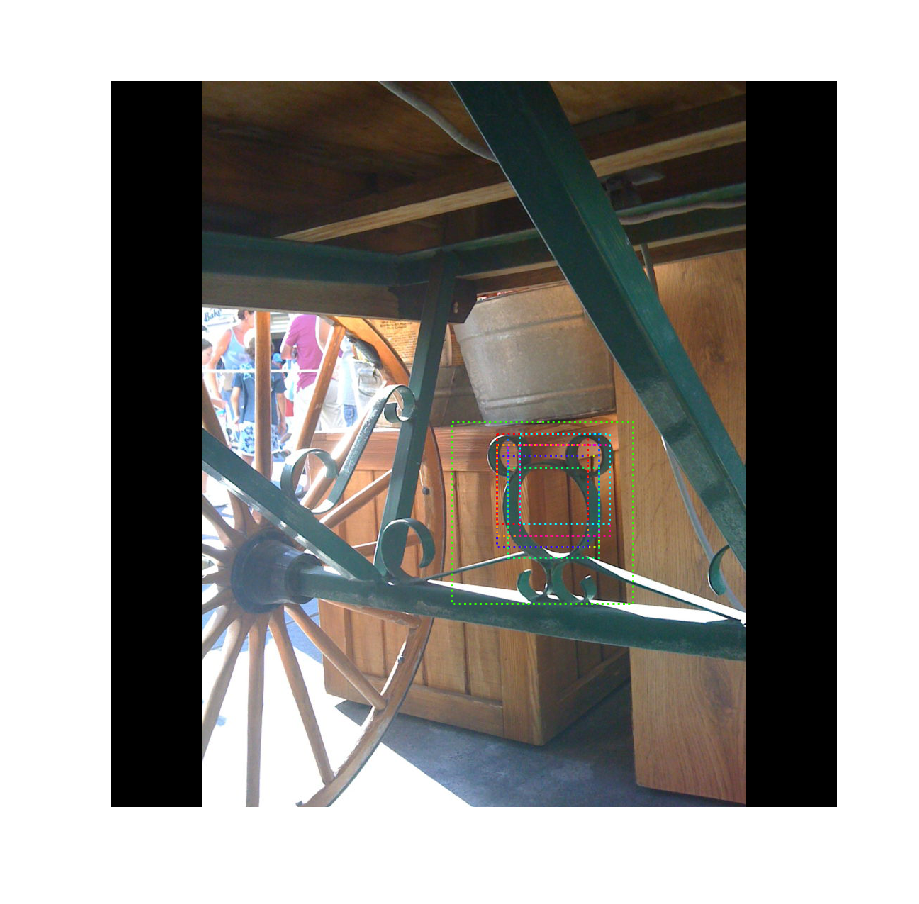

In [17]:
# Show top anchors by score (before refinement)
limit = 10
sorted_anchor_ids = np.argsort(rpn['rpn_class'][:,:,1].flatten())[::-1]
visualize.draw_boxes(image, boxes=model.anchors[sorted_anchor_ids[:limit]], ax=get_ax())

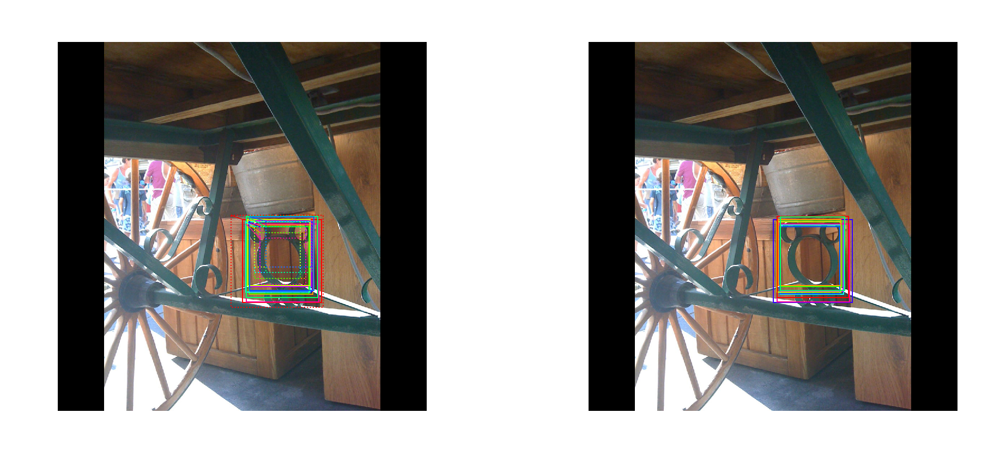

In [18]:
# Show top anchors with refinement. Then with clipping to image boundaries
limit = 10
ax = get_ax(1, 2)

h, w = config.IMAGE_SHAPE[:2]
pre_nms_anchors = rpn["pre_nms_anchors"][0, :limit] * np.array([h, w, h, w])
refined_anchors = rpn["refined_anchors"][0, :limit] * np.array([h, w, h, w])

visualize.draw_boxes(image, boxes=pre_nms_anchors, 
           refined_boxes=refined_anchors, ax=ax[0])

refined_anchors_clipped = rpn["refined_anchors_clipped"][0, :limit] * np.array([h, w, h, w])

visualize.draw_boxes(image, refined_boxes=refined_anchors_clipped, ax=ax[1])

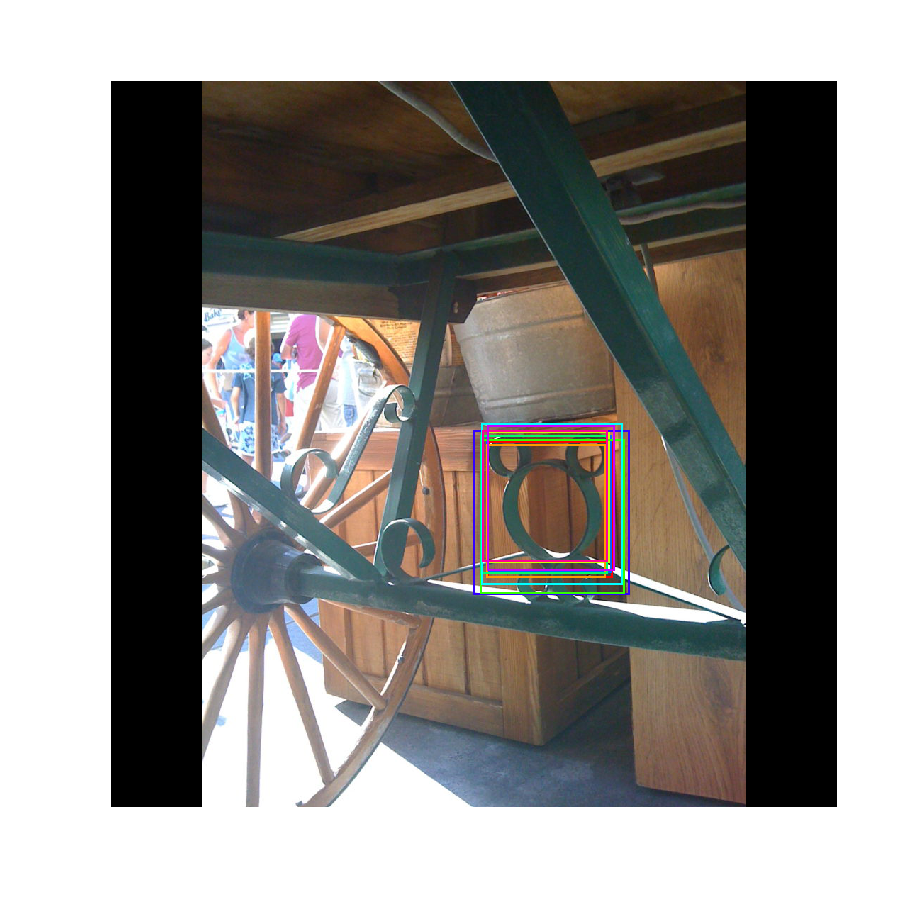

In [19]:
# Show refined anchors after non-max suppression
limit = 10
ixs = rpn["post_nms_anchor_ix"][:limit]
#print(rpn["post_nms_anchor_ix"])
h, w = config.IMAGE_SHAPE[:2]
post_nms_anchors = rpn["refined_anchors_clipped"][0, ixs] * np.array([h, w, h, w])

visualize.draw_boxes(image, refined_boxes=post_nms_anchors, ax=get_ax())

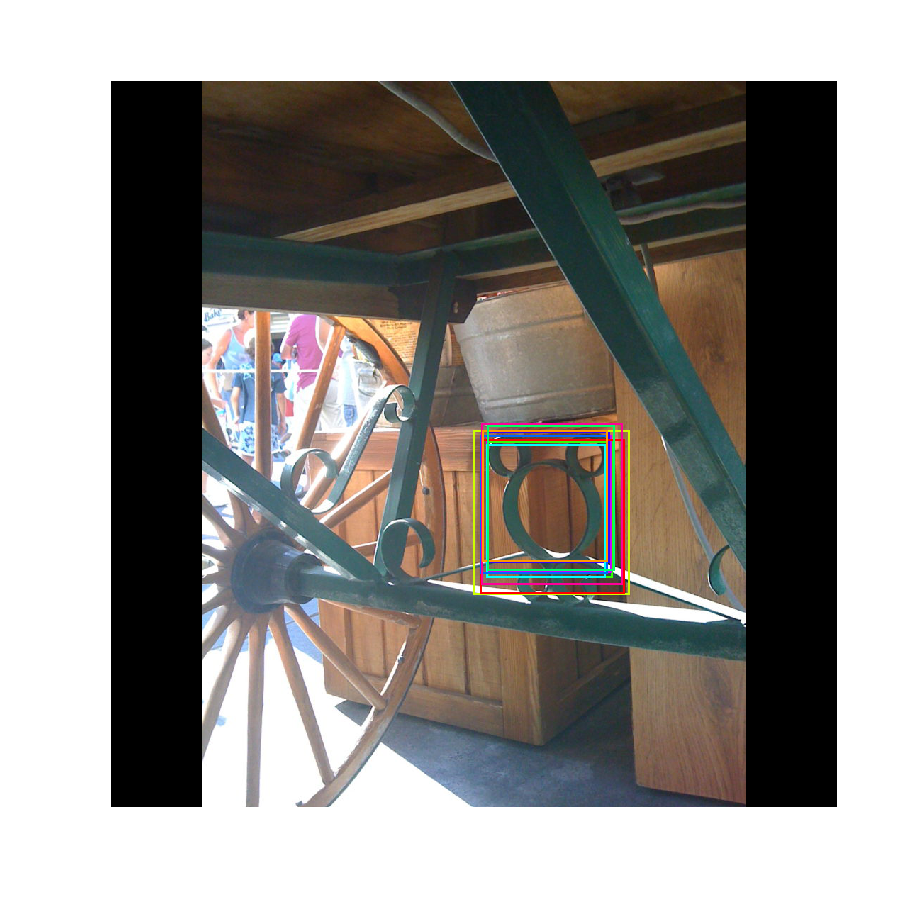

In [20]:
# Show final proposals
# These are the same as the previous step (refined anchors 
# after NMS) but with coordinates normalized to [0, 1] range.
limit = 10
# Convert back to image coordinates for display
h, w = config.IMAGE_SHAPE[:2]
proposals = rpn['proposals'][0, :limit] * np.array([h, w, h, w])
visualize.draw_boxes(image, refined_boxes=proposals, ax=get_ax())

## Stage 2: Proposal Classification

This stage takes the region proposals from the RPN and classifies them.

### 2.a Proposal Classification

Run the classifier heads on proposals to generate class propbabilities and bounding box regressions.

In [21]:
# Get input and output to classifier and mask heads.
mrcnn = model.run_graph([image], [
    ("proposals", model.keras_model.get_layer("ROI").output),
    ("probs", model.keras_model.get_layer("mrcnn_class").output),
    ("deltas", model.keras_model.get_layer("mrcnn_bbox").output),
    ("masks", model.keras_model.get_layer("mrcnn_mask").output),
    ("detections", model.keras_model.get_layer("mrcnn_detection").output),
])

proposals                shape: (1, 1000, 4)          min:    0.00000  max:    1.00000  float32
probs                    shape: (1, 1000, 2)          min:    0.00000  max:    1.00000  float32
deltas                   shape: (1, 1000, 2, 4)       min:   -3.71888  max:    3.12733  float32
masks                    shape: (1, 100, 28, 28, 2)   min:    0.00000  max:    1.00000  float32
detections               shape: (1, 100, 6)           min:    0.00000  max:    1.00000  float32


1 detections: ['mickey']


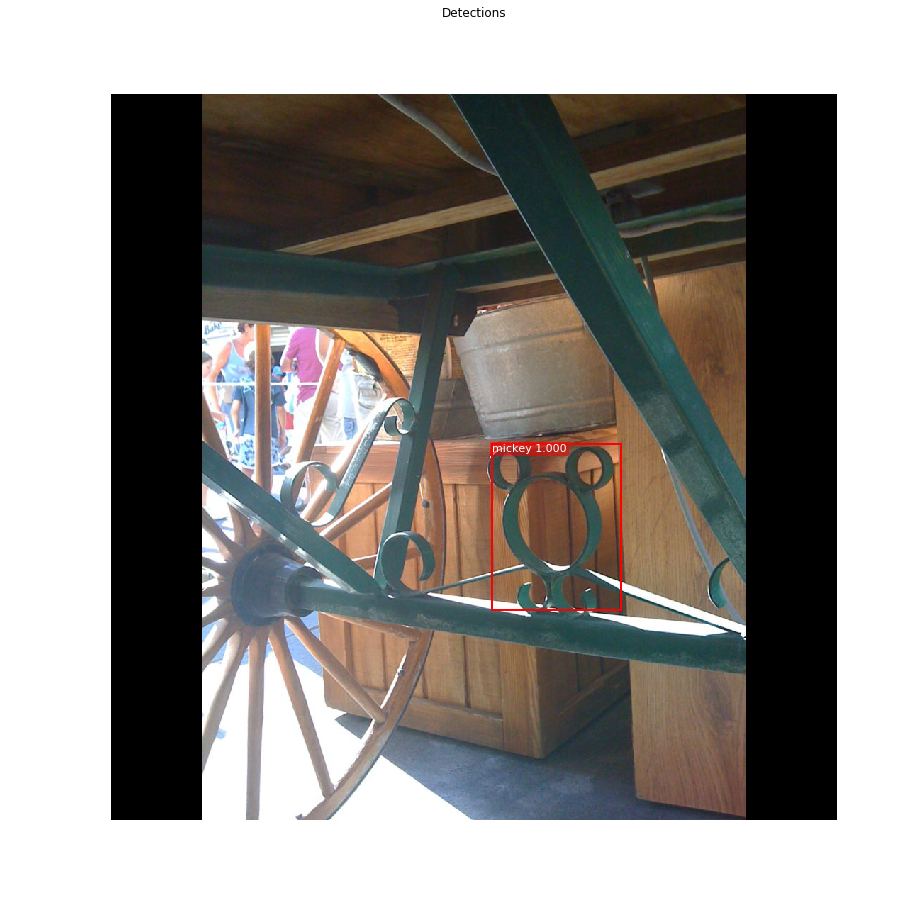

In [22]:
# Get detection class IDs. Trim zero padding.
det_class_ids = mrcnn['detections'][0, :, 4].astype(np.int32)
det_count = np.where(det_class_ids == 0)[0][0]
det_class_ids = det_class_ids[:det_count]
detections = mrcnn['detections'][0, :det_count]

print("{} detections: {}".format(
    det_count, np.array(dataset.class_names)[det_class_ids]))

captions = ["{} {:.3f}".format(dataset.class_names[int(c)], s) if c > 0 else ""
            for c, s in zip(detections[:, 4], detections[:, 5])]
visualize.draw_boxes(
    image, 
    refined_boxes=utils.denorm_boxes(detections[:, :4], image.shape[:2]),
    visibilities=[2] * len(detections),
    captions=captions, title="Detections",
    ax=get_ax())

### 2.c Step by Step Detection

Here we dive deeper into the process of processing the detections.

In [23]:
# Proposals are in normalized coordinates. Scale them
# to image coordinates.
h, w = config.IMAGE_SHAPE[:2]
proposals = np.around(mrcnn["proposals"][0] * np.array([h, w, h, w])).astype(np.int32)

# Class ID, score, and mask per proposal
roi_class_ids = np.argmax(mrcnn["probs"][0], axis=1)
roi_scores = mrcnn["probs"][0, np.arange(roi_class_ids.shape[0]), roi_class_ids]
roi_class_names = np.array(dataset.class_names)[roi_class_ids]
roi_positive_ixs = np.where(roi_class_ids > 0)[0]

#print('roi_scores=', roi_scores)
# How many ROIs vs empty rows?
print("{} Valid proposals out of {}".format(np.sum(np.any(proposals, axis=1)), proposals.shape[0]))
print("{} Positive ROIs".format(len(roi_positive_ixs)))

# Class counts
print(list(zip(*np.unique(roi_class_names, return_counts=True))))

1000 Valid proposals out of 1000
86 Positive ROIs
[('BG', 914), ('mickey', 86)]


Number of proposals: 1000


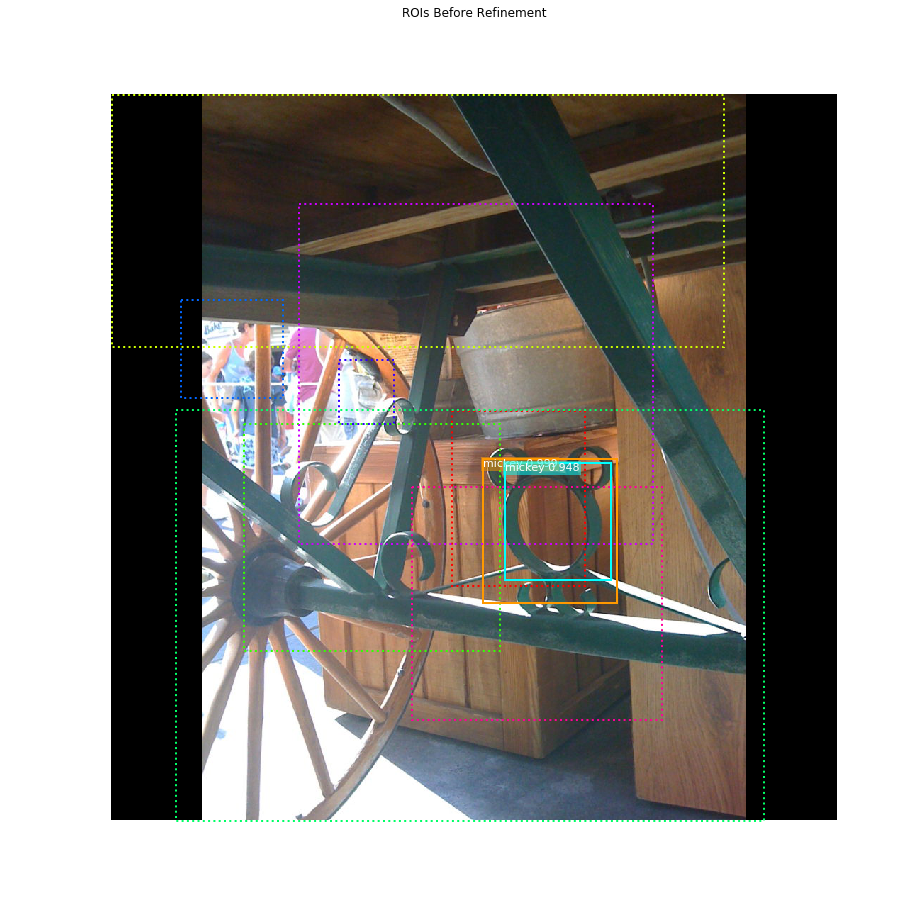

In [24]:
# Display a random sample of proposals.
# Proposals classified as background are dotted, and
# the rest show their class and confidence score.
print('Number of proposals:', proposals.shape[0])
limit = 10
ixs = np.random.randint(0, proposals.shape[0], limit)
captions = ["{} {:.3f}".format(dataset.class_names[c], s) if c > 0 else ""
            for c, s in zip(roi_class_ids[ixs], roi_scores[ixs])]
visualize.draw_boxes(image, boxes=proposals[ixs],
                     visibilities=np.where(roi_class_ids[ixs] > 0, 2, 1),
                     captions=captions, title="ROIs Before Refinement",
                     ax=get_ax())

#### Apply Bounding Box Refinement

roi_bbox_specific        shape: (1000, 4)             min:   -2.14042  max:    3.12733  float32
refined_proposals        shape: (1000, 4)             min: -355.00000  max: 1254.00000  int32


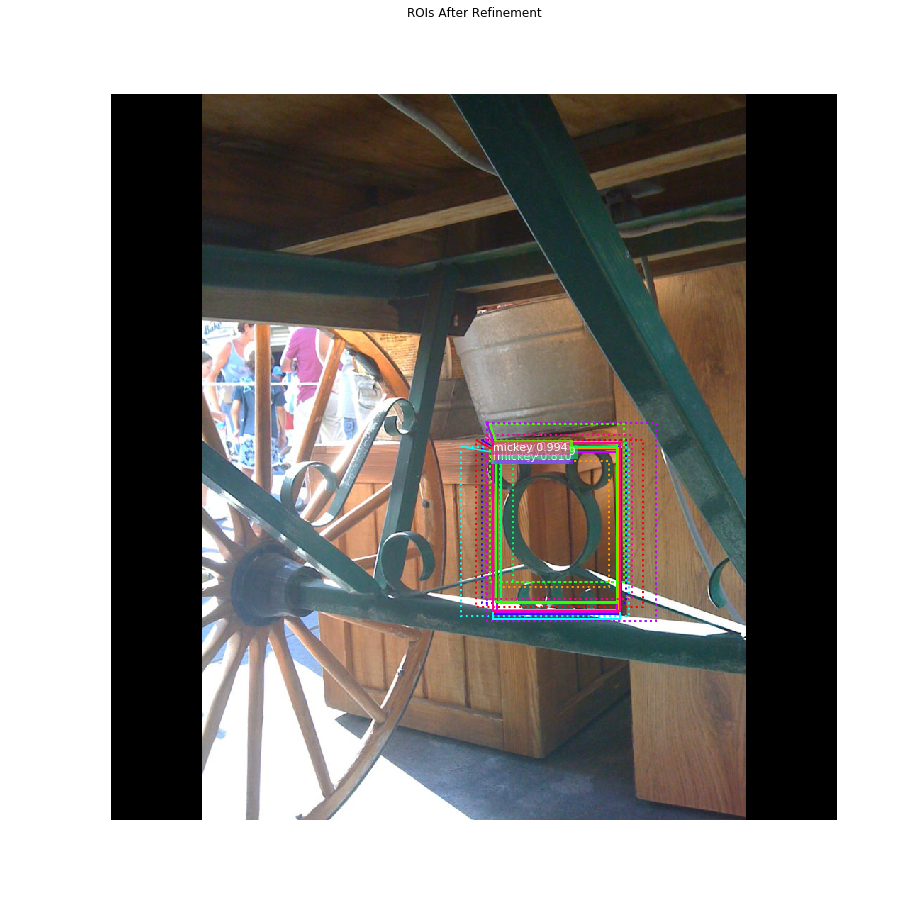

In [25]:
# Class-specific bounding box shifts.
roi_bbox_specific = mrcnn["deltas"][0, np.arange(proposals.shape[0]), roi_class_ids]
log("roi_bbox_specific", roi_bbox_specific)

# Apply bounding box transformations
# Shape: [N, (y1, x1, y2, x2)]
refined_proposals = utils.apply_box_deltas(
    proposals, roi_bbox_specific * config.BBOX_STD_DEV).astype(np.int32)
log("refined_proposals", refined_proposals)

# Show positive proposals
# ids = np.arange(roi_boxes.shape[0])  # Display all
limit = 10
ids = np.random.randint(0, len(roi_positive_ixs), limit)  # Display random sample
captions = ["{} {:.3f}".format(dataset.class_names[c], s) if c > 0 else ""
            for c, s in zip(roi_class_ids[roi_positive_ixs][ids], roi_scores[roi_positive_ixs][ids])]
visualize.draw_boxes(image, boxes=proposals[roi_positive_ixs][ids],
                     refined_boxes=refined_proposals[roi_positive_ixs][ids],
                     visibilities=np.where(roi_class_ids[roi_positive_ixs][ids] > 0, 1, 0),
                     captions=captions, title="ROIs After Refinement",
                     ax=get_ax())

#### Filter Low Confidence Detections

In [26]:
# Remove boxes classified as background
keep = np.where(roi_class_ids > 0)[0]
print("Keep {} detections:\n{}".format(keep.shape[0], keep))

Keep 86 detections:
[  0   1   2   3   4   5   6   7   8   9  10  11  13  15  16  17  19  21
  22  23  27  30  33  34  36  41  48  68  72  74  77  82  83  85  90  92
  94  95  97  99 103 105 109 112 113 118 132 133 150 155 158 159 165 168
 170 179 180 182 186 190 193 194 202 212 216 217 224 291 321 332 337 358
 359 410 412 416 455 481 523 531 544 565 599 677 961 987]


In [27]:
# Remove low confidence detections
keep = np.intersect1d(keep, np.where(roi_scores >= config.DETECTION_MIN_CONFIDENCE)[0])
print("Remove boxes below {} confidence. Keep {}:\n{}".format(
    config.DETECTION_MIN_CONFIDENCE, keep.shape[0], keep))

Remove boxes below 0.55 confidence. Keep 86:
[  0   1   2   3   4   5   6   7   8   9  10  11  13  15  16  17  19  21
  22  23  27  30  33  34  36  41  48  68  72  74  77  82  83  85  90  92
  94  95  97  99 103 105 109 112 113 118 132 133 150 155 158 159 165 168
 170 179 180 182 186 190 193 194 202 212 216 217 224 291 321 332 337 358
 359 410 412 416 455 481 523 531 544 565 599 677 961 987]


#### Per-Class Non-Max Suppression

In [28]:
# Apply per-class non-max suppression
pre_nms_boxes = refined_proposals[keep]
pre_nms_scores = roi_scores[keep]
pre_nms_class_ids = roi_class_ids[keep]

nms_keep = []
for class_id in np.unique(pre_nms_class_ids):
    # Pick detections of this class
    ixs = np.where(pre_nms_class_ids == class_id)[0]
    # Apply NMS
    class_keep = utils.non_max_suppression(pre_nms_boxes[ixs], 
                                            pre_nms_scores[ixs],
                                            config.DETECTION_NMS_THRESHOLD)
    # Map indicies
    class_keep = keep[ixs[class_keep]]
    nms_keep = np.union1d(nms_keep, class_keep)
    print("{:22}: {} -> {}".format(dataset.class_names[class_id][:20], 
                                   keep[ixs], class_keep))

keep = np.intersect1d(keep, nms_keep).astype(np.int32)
print("\nKept after per-class NMS: {}\n{}".format(keep.shape[0], keep))

mickey                : [  0   1   2   3   4   5   6   7   8   9  10  11  13  15  16  17  19  21
  22  23  27  30  33  34  36  41  48  68  72  74  77  82  83  85  90  92
  94  95  97  99 103 105 109 112 113 118 132 133 150 155 158 159 165 168
 170 179 180 182 186 190 193 194 202 212 216 217 224 291 321 332 337 358
 359 410 412 416 455 481 523 531 544 565 599 677 961 987] -> [186]

Kept after per-class NMS: 1
[186]


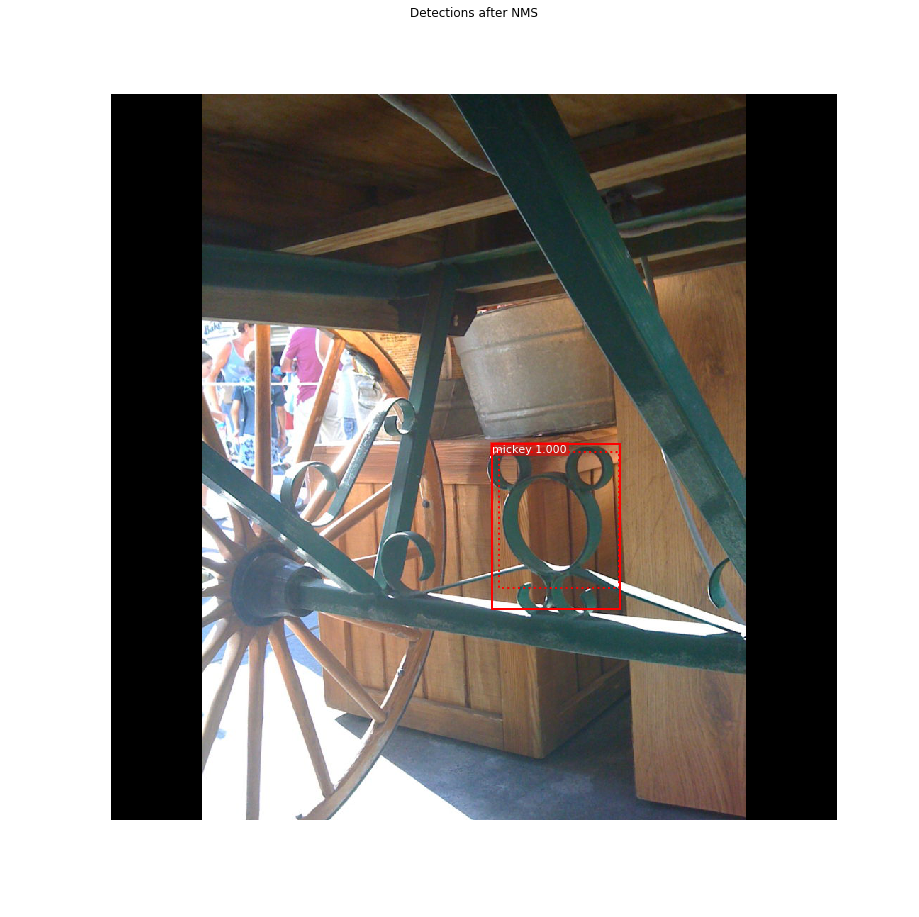

In [29]:
# Show final detections
ixs = np.arange(len(keep))  # Display all
# ixs = np.random.randint(0, len(keep), 10)  # Display random sample
captions = ["{} {:.3f}".format(dataset.class_names[c], s) if c > 0 else ""
            for c, s in zip(roi_class_ids[keep][ixs], roi_scores[keep][ixs])]
visualize.draw_boxes(
    image, boxes=proposals[keep][ixs],
    refined_boxes=refined_proposals[keep][ixs],
    visibilities=np.where(roi_class_ids[keep][ixs] > 0, 1, 0),
    captions=captions, title="Detections after NMS",
    ax=get_ax())

## Stage 3: Generating Masks

This stage takes the detections (refined bounding boxes and class IDs) from the previous layer and runs the mask head to generate segmentation masks for every instance.

### 3.a Mask Targets

These are the training targets for the mask branch

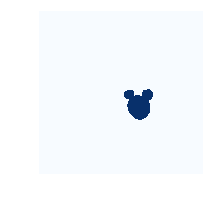

In [30]:
display_images(np.transpose(gt_mask, [2, 0, 1]), cmap="Blues")

### 3.b Predicted Masks

In [31]:
# Get predictions of mask head
mrcnn = model.run_graph([image], [
    ("detections", model.keras_model.get_layer("mrcnn_detection").output),
    ("masks", model.keras_model.get_layer("mrcnn_mask").output),
])

# Get detection class IDs. Trim zero padding.
det_class_ids = mrcnn['detections'][0, :, 4].astype(np.int32)
det_count = np.where(det_class_ids == 0)[0][0]
det_class_ids = det_class_ids[:det_count]

print("{} detections: {}".format(
    det_count, np.array(dataset.class_names)[det_class_ids]))

detections               shape: (1, 100, 6)           min:    0.00000  max:    1.00000  float32
masks                    shape: (1, 100, 28, 28, 2)   min:    0.00000  max:    1.00000  float32
1 detections: ['mickey']


In [32]:
# Masks
det_boxes = utils.denorm_boxes(mrcnn["detections"][0, :, :4], image.shape[:2])
det_mask_specific = np.array([mrcnn["masks"][0, i, :, :, c] 
                              for i, c in enumerate(det_class_ids)])
det_masks = np.array([utils.unmold_mask(m, det_boxes[i], image.shape)
                      for i, m in enumerate(det_mask_specific)])
log("det_mask_specific", det_mask_specific)
log("det_masks", det_masks)

det_mask_specific        shape: (1, 28, 28)           min:    0.00000  max:    1.00000  float32
det_masks                shape: (1, 1024, 1024)       min:    0.00000  max:    1.00000  bool


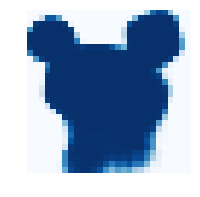

In [33]:
display_images(det_mask_specific[:20] * 255, cmap="Blues", interpolation="none")

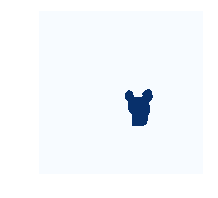

In [34]:
display_images(det_masks[:20] * 255, cmap="Blues", interpolation="none")

## Visualize Activations

In some cases it helps to look at the output from different layers and visualize them to catch issues and odd patterns.

In [35]:
# Get activations of a few sample layers
activations = model.run_graph([image], [
    #("input_image",        model.keras_model.get_layer("input_image").output),
    ("res4w_out",          model.keras_model.get_layer("res4w_out").output),  # for resnet100
    ("res2c_out",          model.keras_model.get_layer("res2c_out").output),    
    ("rpn_bbox",           model.keras_model.get_layer("rpn_bbox").output),
    ("roi",                model.keras_model.get_layer("ROI").output),
])

res4w_out                shape: (1, 64, 64, 1024)     min:    0.00000  max:   65.01810  float32
res2c_out                shape: (1, 256, 256, 256)    min:    0.00000  max:   31.16413  float32
rpn_bbox                 shape: (1, 261888, 4)        min:   -6.98738  max:   46.77660  float32
roi                      shape: (1, 1000, 4)          min:    0.00000  max:    1.00000  float32


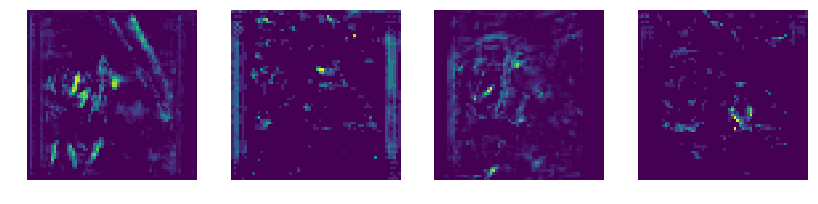

In [36]:
# Backbone feature map
display_images(np.transpose(activations["res4w_out"][0,:,:,:4], [2, 0, 1]))

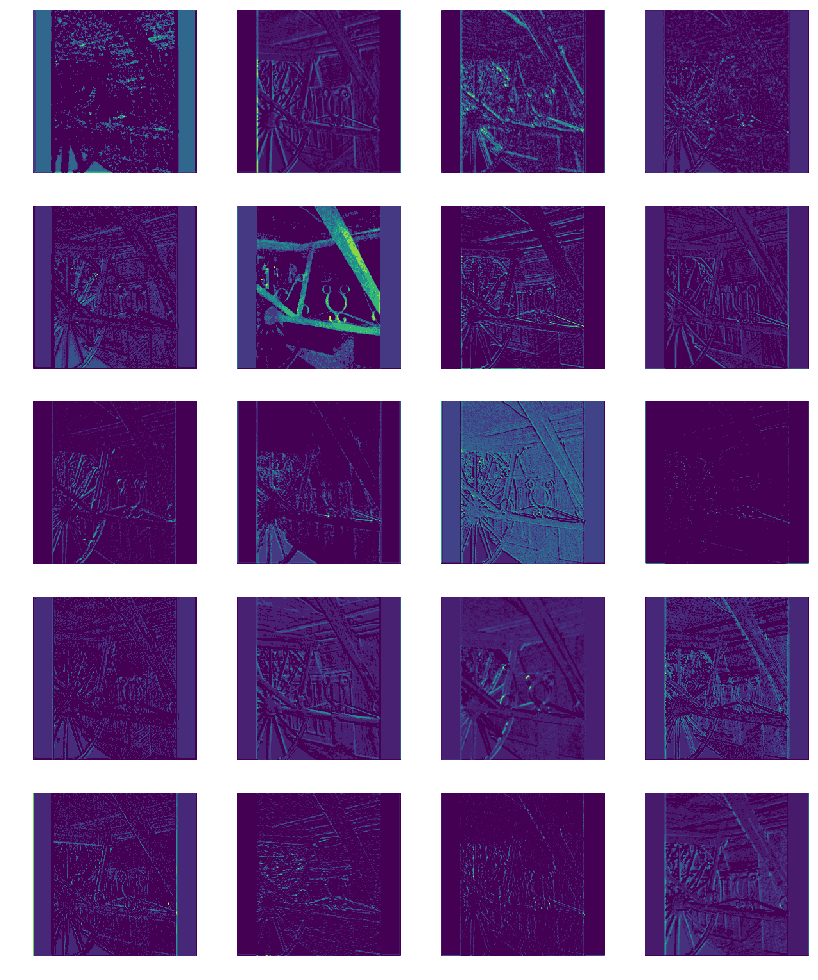

In [37]:
# Backbone feature map
display_images(np.transpose(activations["res2c_out"][0,:,:,:20], [2, 0, 1]), cols=4)

In [ ]:
# Histograms of RPN bounding box deltas
plt.figure(figsize=(12, 3))
plt.subplot(1, 4, 1)
plt.title("dy")
_ = plt.hist(activations["rpn_bbox"][0,:,0], 50)
plt.subplot(1, 4, 2)
plt.title("dx")
_ = plt.hist(activations["rpn_bbox"][0,:,1], 50)
plt.subplot(1, 4, 3)
plt.title("dw")
_ = plt.hist(activations["rpn_bbox"][0,:,2], 50)
plt.subplot(1, 4, 4)
plt.title("dh")
_ = plt.hist(activations["rpn_bbox"][0,:,3], 50)

In [ ]:
# Distribution of y, x coordinates of generated proposals
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.title("y1, x1")
plt.scatter(activations["roi"][0,:,0], activations["roi"][0,:,1])
plt.subplot(1, 2, 2)
plt.title("y2, x2")
plt.scatter(activations["roi"][0,:,2], activations["roi"][0,:,3])
plt.show()

In [ ]:
# Get activations of a few sample layers
activations = model.run_graph([image], [
    ("activation_1",        model.keras_model.get_layer("activation_1").output),
    ("activation_2",        model.keras_model.get_layer("activation_2").output),
    ("activation_3",        model.keras_model.get_layer("activation_3").output),
    ("res2a_out",          model.keras_model.get_layer("res2a_out").output),
    ("activation_4",        model.keras_model.get_layer("activation_4").output),
    ("res2c_out",          model.keras_model.get_layer("res2c_out").output),
    ("res3c_out",          model.keras_model.get_layer("res3c_out").output),
    ("res4w_out",          model.keras_model.get_layer("res4w_out").output),  # for resnet100
    ("rpn_bbox",           model.keras_model.get_layer("rpn_bbox").output),
    ("roi",                model.keras_model.get_layer("ROI").output),
])

In [ ]:
display_images(np.transpose(activations["activation_1"][0,:,:,:10], [2, 0, 1]))

In [ ]:
display_images(np.transpose(activations["activation_2"][0,:,:,:10], [2, 0, 1]))

In [ ]:
display_images(np.transpose(activations["activation_3"][0,:,:,:10], [2, 0, 1]))

In [ ]:
display_images(np.transpose(activations["res2a_out"][0,:,:,:10], [2, 0, 1]))

In [ ]:
display_images(np.transpose(activations["activation_4"][0,:,:,:10], [2, 0, 1]))